In [36]:
import os
import time
import shutil
import pickle
from copy import deepcopy
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from tqdm import tqdm
import matplotlib.pyplot as plt
import torch
import numpy as np
from torch import nn, optim
import torch.nn.functional as F
import torch.utils.data as data
from torchvision import datasets, transforms, models
from torchinfo import summary
import torchvision
from torchvision.models import resnet50
from transformers import AutoImageProcessor, ViTForImageClassification
from PIL import Image
plt.style.use("https://github.com/dhaitz/matplotlib-stylesheets/raw/master/pitayasmoothie-dark.mplstyle")

In [37]:
# Checking the GPU detection
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(device)

cuda


# Data Preparation

In [38]:
# Creating directories
dataset_dir = '/mnt/DL/Projects/Marble defect classification/Dataset/'
train_directory = '/mnt/DL/Projects/Marble defect classification/Dataset/train'
val_directory = '/mnt/DL/Projects/Marble defect classification/Dataset/val'
test_directory = '/mnt/DL/Projects/Marble defect classification/Dataset/test'

# Creating configuration dict
CONFIGURATION = {
    "BATCH_SIZE": 32,
    "IM_SIZE": 256,
    "LEARNING_RATE": 1e-3,
    "N_EPOCHS": 1000,
    "CLASS_NAMES": ["defective", "good"],
    "NUM_WORKERS" : os.cpu_count()
}

In [39]:
# Making sure all the images are working correctly and not corrupted
# def clean_img_dir(image_dir):
#     corrupted = []
#     for root, dirs, files in os.walk(image_dir):
#         for file in files:
#             image_path = os.path.join(root, file)
#             try:
#                 with Image.open(image_path) as img:
#                     img.load()
#             except(IOError, OSError) as e:
#                 corrupted.append(image_path)
#                 os.remove(image_path)
#     return "The following corrupted images have been removed:" + "\n".join(corrupted)

In [40]:
# clean_img_dir(dataset_dir)

## ResNet

In [23]:
# Transformations and splitting
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomResizedCrop(240),
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(p=0.3),
    transforms.RandomRotation(degrees=10),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
])

transform_2 = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
])


# Create the full dataset with the training transformations
full_train_dataset = datasets.ImageFolder(root=train_directory, transform=transform)

# Splitting the train dataset into train-val
train_ratio = 0.8
val_ratio = 1 - train_ratio
train_size = int(train_ratio * len(full_train_dataset))
val_size = len(full_train_dataset) - train_size

train_dataset, _ = data.random_split(full_train_dataset, [train_size, val_size])

# Create a new validation dataset with transform_2
val_dataset = datasets.ImageFolder(root=train_directory, transform=transform_2)
_, val_dataset = data.random_split(val_dataset, [train_size, val_size])

# Create the test dataset
test_dataset = datasets.ImageFolder(root=test_directory, transform=transform_2)

# Create data loaders
train_loader = data.DataLoader(train_dataset, batch_size=CONFIGURATION['BATCH_SIZE'], shuffle=True, num_workers=CONFIGURATION['NUM_WORKERS'], pin_memory=True)
val_loader = data.DataLoader(val_dataset, batch_size=CONFIGURATION['BATCH_SIZE'], shuffle=False, num_workers=CONFIGURATION['NUM_WORKERS'], pin_memory=True)
test_loader = data.DataLoader(test_dataset, batch_size=CONFIGURATION['BATCH_SIZE'], shuffle=True, num_workers=CONFIGURATION['NUM_WORKERS'], pin_memory=True)

dataloaders = {
    'TRAIN': train_loader,
    'VAL': val_loader,
    'TEST': test_loader
}

dataset_sizes = {
    'TRAIN': len(train_loader.dataset),
    'VAL': len(val_loader.dataset),
    'TEST': len(test_loader.dataset)
}

## ViT (Pretrained)

In [64]:
# ViT transformations
vit_transform_train = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(p=0.3),
    transforms.RandomRotation(degrees=10),
    transforms.ToTensor(),
])

vit_transform_val_test = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

vit_full_train_dataset = datasets.ImageFolder(root=train_directory, transform=vit_transform_train)

vit_train_dataset, _ = data.random_split(vit_full_train_dataset, [train_size, val_size])

vit_val_dataset = datasets.ImageFolder(root=train_directory, transform=vit_transform_val_test)
_, vit_val_dataset = data.random_split(vit_val_dataset, [train_size, val_size])

vit_test_dataset = datasets.ImageFolder(root=test_directory, transform=vit_transform_val_test)

# Create data loaders
vit_train_loader = data.DataLoader(vit_train_dataset, batch_size=32, shuffle=True, num_workers=8, pin_memory=True)
vit_val_loader = data.DataLoader(vit_val_dataset, batch_size=32, shuffle=False, num_workers=8, pin_memory=True)
vit_test_loader = data.DataLoader(vit_test_dataset, batch_size=32, shuffle=True, num_workers=8, pin_memory=True)

vit_dataloaders = {
    'TRAIN': vit_train_loader,
    'VAL': vit_val_loader,
    'TEST': vit_test_loader
}

# Data visualization

In [65]:
# Number of images in each folder for each category
def get_count(folder_path):
    return f"The number of images in {os.path.split(folder_path)[-1]} is:{sum(len(files) for root, dirs, files in os.walk(folder_path))}"
get_count(train_directory), get_count(test_directory)

('The number of images in train is:2249',
 'The number of images in test is:688')

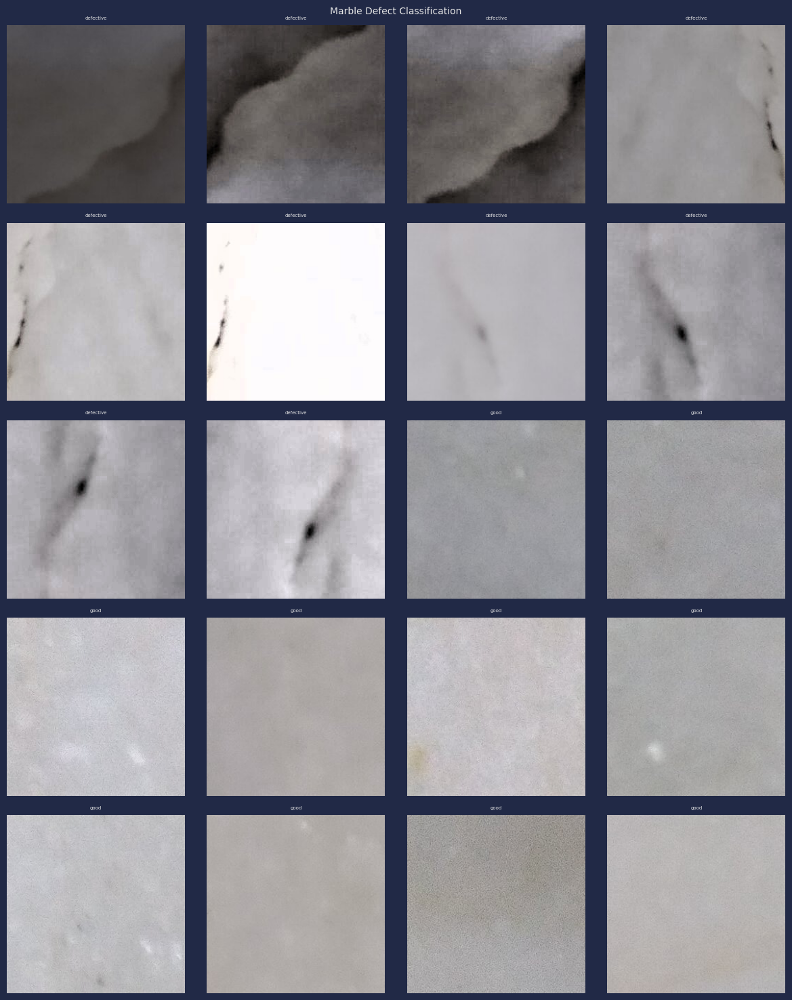

In [66]:
def load_images_from_subfolders(base_folder: str, num_images_per_folder: int = 5):
    """A function that randomly selects a specified number of images per folder in a directory
    Args:
        base_folder (str): directory of images
        num_images_per_folder (int, optional): Defaults to 5.
    Returns:
        image_dict: a dictionary containing the subfolder directories and their image paths
    """
    image_dict = {}
    for subfolder in os.listdir(base_folder):
        subfolder_path = os.path.join(base_folder,subfolder)
        rand = np.random.randint(low=0, high=len(subfolder_path)-num_images_per_folder)
        for file_path in os.listdir(subfolder_path)[rand:rand+num_images_per_folder]:
            if os.path.splitext(file_path)[1].lower() in ['.jpg', '.png', '.webp', '.jpeg']:
                if image_dict.get(subfolder_path):
                    image_dict[subfolder_path] += [file_path]
                else:
                    image_dict[subfolder_path] = [file_path]
            
    
    return image_dict        
        

# def plot_images_in_grid(images, subfolder_names, num_images_per_row):
#     total_images = sum(len(folder_images) for folder_images in images)
#     num_rows = (total_images + num_images_per_row - 1) // num_images_per_row

#     fig, axes = plt.subplots(num_rows, num_images_per_row, figsize=(15, 3 * num_rows))
#     fig.suptitle("Marble defect classification", fontsize=20)

#     ax_index = 0
#     for folder_images, subfolder_name in zip(images, subfolder_names):
#         for img in folder_images:
#             row = ax_index // num_images_per_row # 0,0,0,1,1,1,2,2,2...
#             col = ax_index % num_images_per_row # 0,1,2,3,0,1,2,3...
#             ax = axes[row, col] if num_rows > 1 else axes[col]
#             ax.imshow(img)
#             ax.axis('off')
#             ax.set_title(subfolder_name, fontsize=10)
#             ax_index += 1

#     # Remove empty subplots
#     for i in range(ax_index, num_rows * num_images_per_row):
#         row = i // num_images_per_row
#         col = i % num_images_per_row
#         ax = axes[row, col] if num_rows > 1 else axes[col]
#         ax.remove()

#     plt.tight_layout()
#     plt.show()
def plot_images_in_grid(image_dict, num_images_per_row, title):
    total_images = len(image_dict.keys()) * len(image_dict[next(iter(image_dict))])
    
    if total_images < 1:
        return "The folders contain no images. Please input a directory that has images"
    
    if num_images_per_row < 1:
        return "The number of images per row must be above 1"
    
    num_rows = int(np.ceil(total_images / num_images_per_row))
    
    fig, axes = plt.subplots(num_rows, num_images_per_row, figsize=(int(num_images_per_row*3), 3*num_rows))
    fontsize = 2*num_rows
    fig.suptitle(title, fontsize=fontsize)
    
    ax_index=0
    for folder_dir in image_dict.keys():
        for image_name in image_dict[folder_dir]:
            img_path = os.path.join(folder_dir, image_name)
            try:
                img = Image.open(img_path)
            except Exception as e:
                raise f"Error loading image {img_path}: {e}"
            row = ax_index // num_images_per_row
            col = ax_index % num_images_per_row
            ax = axes[row,col] if num_rows > 1 else axes[col]
            ax.imshow(img)
            ax.axis('off')
            ax.set_title(os.path.basename(os.path.normpath(folder_dir)), fontsize=int(0.5*fontsize))
            ax_index += 1
            
    plt.tight_layout()
    plt.show()

image_dict = load_images_from_subfolders(train_directory, num_images_per_folder=10)
plot_images_in_grid(image_dict=image_dict, num_images_per_row=4, title="Marble Defect Classification")

In [79]:
def show_databatch(images, labels, class_names, n_rows=2, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225], unnormalize=True):
    """
    Display a batch of images with their labels in a grid with specified number of rows.

    Args:
        images (Tensor): Batch of images.
        labels (Tensor or list): Corresponding labels for the images.
        class_names (list): List of class names.
        n_rows (int): Number of rows for the grid.
        mean (list): Mean for unnormalization.
        std (list): Standard deviation for unnormalization.
    """
    # Unnormalize

    images = images.numpy().transpose((0, 2, 3, 1))  # Convert from (N, C, H, W) to (N, H, W, C)
    if unnormalize:
        mean = np.array(mean)
        std = np.array(std)
        images = std * images + mean
        images = np.clip(images, 0, 1)

    # Convert labels to string representations
    labels = [class_names[label] if isinstance(label, torch.Tensor) else class_names[int(label)] for label in labels]

    # Calculate number of columns based on n_rows
    n_images = len(images)
    n_cols = (n_images + n_rows - 1) // n_rows

    # Create a grid of images
    grid_img = torchvision.utils.make_grid(torch.tensor(images.transpose((0, 3, 1, 2))), nrow=n_cols)
    grid_img = grid_img.numpy().transpose((1, 2, 0))
    # Plot the grid
    plt.figure(figsize=(n_cols * 2, n_rows * 2))
    plt.imshow(grid_img)
    plt.axis('off')

    # Calculate the width of a single image in the grid (including padding)
    single_img_width = grid_img.shape[1] / n_cols
    single_image_height = grid_img.shape[0] / n_rows

    # Plot labels as titles
    for i in range(n_images):
        x = (i % n_cols + 0.5) * single_img_width  # Center the text for each image
        y = (i // n_cols + 1) * single_image_height - 10
        plt.text(x, y, labels[i], fontsize=12, color='white', backgroundcolor='black', 
                 ha='center', va='bottom')  # Adjust horizontal and vertical alignment

    plt.show()

images, labels = next(iter(train_loader))
show_databatch(images, labels, CONFIGURATION['CLASS_NAMES'], n_rows=3)

IndexError: list index out of range

In [77]:
# Visualizing the model's predictions (will be executed after training)
def visualize_model(model, dataloaders, num_rows=2, num_batches=3, use_gpu=True, unnormalize=True):
    was_training = model.training
    model.eval()
    batches_so_far = 0
    
    for i, (inputs, labels) in enumerate(dataloaders['TEST']):
        if use_gpu:
            inputs = inputs.cuda(non_blocking=True)
            labels = labels.cuda(non_blocking=True)
        labels.unsqueeze(1).float()
        size = inputs.size()[0]

        with torch.no_grad():
            outputs = model(inputs)
            probs = torch.sigmoid(outputs)
            preds = probs.round()

        predicted_labels = preds.cpu().numpy()

        print("Ground truth:")
        show_databatch(inputs.cpu(), labels.cpu(), CONFIGURATION['CLASS_NAMES'], n_rows=num_rows, unnormalize=unnormalize)
        
        print("Prediction:")
        show_databatch(inputs.cpu(), predicted_labels, CONFIGURATION['CLASS_NAMES'],  n_rows=num_rows, unnormalize=unnormalize)
        
        batches_so_far += 1
        
        if batches_so_far >num_batches:
            break

    model.train(was_training)  # Revert model back to original training state

In [69]:
# # Due to the small amount of images inside each category, It would be better to train a model that classifies whether a marble is defective or OK
# # Let's construct the two new folders: defective, good
# os.makedirs('/mnt/DL/Projects/Marble defect classification/Dataset/train/defective', exist_ok=True)
# os.makedirs('/mnt/DL/Projects/Marble defect classification/Dataset/test/defective', exist_ok=True)
# main_dirs = [train_directory, test_directory]
# # Moving defective train images to their folder
# for main_dir in main_dirs:
#     for root, dirs, files in os.walk(dir):
#         for dir in dirs:
#             if dir in ['crack', 'dot', 'joint']:
#                 image_names = os.listdir(root+"/" +dir)
#                 for image_name in image_names:
#                     # print(root+'/'+dir+'/'+ image_name)
#                     shutil.move(src=root+'/'+dir+'/'+ image_name, dst=root+'/'+'defective')
#                 # print(root+'/'+dir)
# # Delete the other empty folders
# empty = ['crack', 'dot', 'joint']
# for folder in empty:
#     os.removedirs('/mnt/DL/Projects/Marble defect classification/Dataset/train/'+ folder)
#     os.removedirs('/mnt/DL/Projects/Marble defect classification/Dataset/test/'+ folder)

# Modeling

## ResNet34 (Implementation from scratch)

In [59]:
# Define the BasicBlock class used in ResNet-34
class BasicBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1, downsample=None):
        """
        Initializes the BasicBlock with two 3x3 convolutional layers.
        
        Args:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.
            stride (int): Stride of the convolution.
            downsample (nn.Module, optional): Downsample layer if needed.
        """
        super(BasicBlock, self).__init__()
        # First convolutional layer, followed by batch normalization and ReLU activation
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)

        # Second convolutional layer, followed by batch normalization
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)

        # Downsample layer to match the dimensions if required
        self.downsample = downsample

    def forward(self, x):
        """
        Forward pass for the BasicBlock.

        Args:
            x (Tensor): Input tensor.

        Returns:
            Tensor: Output tensor after applying the block.
        """
        identity = x  # Save the input (identity) for the residual connection

        # First convolution + batch norm + ReLU
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        # Second convolution + batch norm
        out = self.conv2(out)
        out = self.bn2(out)

        # If there's a downsample, apply it to the identity
        if self.downsample:
            identity = self.downsample(x)

        # Add the identity (residual connection)
        out += identity
        # Apply ReLU activation to the output
        out = self.relu(out)

        return out


# Define the overall ResNet architecture
class ResNet(nn.Module):
    def __init__(self, block, layers, num_classes=1000):
        """
        Initializes the ResNet model.
        
        Args:
            block (nn.Module): The block used in the model (e.g., BasicBlock).
            layers (list): List containing the number of blocks in each layer.
            num_classes (int): Number of output classes.
        """
        super(ResNet, self).__init__()
        self.in_channels = 64  # Initial number of input channels

        # Initial convolutional layer, followed by batch norm, ReLU, and max pooling
        self.conv1 = nn.Conv2d(3, self.in_channels, kernel_size=7, stride=2, padding=3, bias=False)
        self.bn1 = nn.BatchNorm2d(self.in_channels)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)

        # Define the four layers of the ResNet, each with a different number of blocks
        self.layer1 = self._make_layer(block, 64, layers[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2)

        # Adaptive average pooling followed by a fully connected layer
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(512, num_classes)

        # Initialize weights
        self._initialize_weights()

    def _make_layer(self, block, out_channels, blocks, stride=1):
        """
        Creates a layer consisting of multiple blocks.
        
        Args:
            block (nn.Module): The block to be used (e.g., BasicBlock).
            out_channels (int): Number of output channels.
            blocks (int): Number of blocks in this layer.
            stride (int): Stride of the first block.

        Returns:
            nn.Sequential: A sequential container of blocks forming the layer.
        """
        downsample = None

        # If stride is not 1, or the input channels do not match the output channels, 
        # create a downsample layer to match dimensions
        if stride != 1 or self.in_channels != out_channels:
            downsample = nn.Sequential(
                nn.Conv2d(self.in_channels, out_channels, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(out_channels),
            )

        layers = []
        # First block may have a different stride and may require downsampling
        layers.append(block(self.in_channels, out_channels, stride, downsample))
        self.in_channels = out_channels  # Update in_channels for subsequent blocks

        # Add the remaining blocks, all with stride=1
        for _ in range(1, blocks):
            layers.append(block(self.in_channels, out_channels))

        return nn.Sequential(*layers)

    def _initialize_weights(self):
        """
        Initializes the weights of the model.
        """
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.normal_(m.weight, 0, 0.01)
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        """
        Forward pass for the ResNet model.

        Args:
            x (Tensor): Input tensor.

        Returns:
            Tensor: Output tensor after passing through the ResNet.
        """
        # Pass input through initial convolution, batch norm, ReLU, and max pool
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        # Pass through each of the four layers
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        # Apply adaptive average pooling and flatten the result
        x = self.avgpool(x)
        x = torch.flatten(x, 1)

        # Pass through the fully connected layer
        x = self.fc(x)

        return x


# Define a helper function to create ResNet-34
def make_resnet34(num_classes=1000):
    """
    Constructs a ResNet-34 model.

    Args:
        num_classes (int): Number of output classes.

    Returns:
        ResNet: The ResNet-34 model.
    """
    return ResNet(BasicBlock, [3, 4, 6, 3], num_classes)


# Test function to verify the ResNet implementation
def test():
    """
    Tests the ResNet-34 implementation with a random input tensor.
    """
    BATCH_SIZE = 4
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Instantiate ResNet-34 model and move it to the device (CPU or GPU)
    net = make_resnet34(num_classes=1000).to(device)

    # Generate a random input tensor with batch size 4 and 3x224x224 dimensions
    y = net(torch.randn(BATCH_SIZE, 3, 224, 224).to(device))

    # Check if the output has the expected shape [BATCH_SIZE, 1000]
    assert y.size() == torch.Size([BATCH_SIZE, 1000])
    print(y.size())  # Print the size of the output tensor


# If this script is executed, run the test function
if __name__ == "__main__":
    test()

torch.Size([4, 1000])


In [60]:
resnet34 = make_resnet34(num_classes=1)
summary(model=resnet34, 
        input_size=(32, 3, 224, 224), # (batch_size, color_channels, height, width)
        # col_names=["input_size"], # uncomment for smaller output
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

Layer (type (var_name))                  Input Shape          Output Shape         Param #              Trainable
ResNet (ResNet)                          [32, 3, 224, 224]    [32, 1]              --                   True
├─Conv2d (conv1)                         [32, 3, 224, 224]    [32, 64, 112, 112]   9,408                True
├─BatchNorm2d (bn1)                      [32, 64, 112, 112]   [32, 64, 112, 112]   128                  True
├─ReLU (relu)                            [32, 64, 112, 112]   [32, 64, 112, 112]   --                   --
├─MaxPool2d (maxpool)                    [32, 64, 112, 112]   [32, 64, 56, 56]     --                   --
├─Sequential (layer1)                    [32, 64, 56, 56]     [32, 64, 56, 56]     --                   True
│    └─BasicBlock (0)                    [32, 64, 56, 56]     [32, 64, 56, 56]     --                   True
│    │    └─Conv2d (conv1)               [32, 64, 56, 56]     [32, 64, 56, 56]     36,864               True
│    │    └─BatchN

In [69]:
# num_features = resnet34.fc.in_features  # Get the number of input features to the final layer

# # Replace the final fully connected layer
# resnet34.fc = torch.nn.Linear(num_features, 1)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
resnet34 = resnet34.to(device)

criterion = torch.nn.BCELoss()
optimizer = optim.SGD(resnet34.parameters(), lr=0.001, momentum=0.9)
optimizer = torch.optim.Adam(params=resnet34.parameters(), 
                             lr=CONFIGURATION['LEARNING_RATE'])
exp_lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=0.1)

## ResNet50 (Pretrained)

In [89]:
# We will use pretrained ResNet50, pretrained EffecientNet, and finally a pretrained ViT model and compare the results later
# ResNet50: image_size = (256, 256,3)

weights = models.ResNet50_Weights.DEFAULT
resnet_model = resnet50(weights=weights).to('cuda')

Layer (type (var_name))                  Input Shape          Output Shape         Param #              Trainable
ResNet (ResNet)                          [32, 3, 224, 224]    [32, 1000]           --                   True
├─Conv2d (conv1)                         [32, 3, 224, 224]    [32, 64, 112, 112]   9,408                True
├─BatchNorm2d (bn1)                      [32, 64, 112, 112]   [32, 64, 112, 112]   128                  True
├─ReLU (relu)                            [32, 64, 112, 112]   [32, 64, 112, 112]   --                   --
├─MaxPool2d (maxpool)                    [32, 64, 112, 112]   [32, 64, 56, 56]     --                   --
├─Sequential (layer1)                    [32, 64, 56, 56]     [32, 256, 56, 56]    --                   True
│    └─Bottleneck (0)                    [32, 64, 56, 56]     [32, 256, 56, 56]    --                   True
│    │    └─Conv2d (conv1)               [32, 64, 56, 56]     [32, 64, 56, 56]     4,096                True
│    │    └─BatchN

In [57]:
num_features = resnet_model.fc.in_features  # Get the number of input features to the final layer

# Replace the final fully connected layer
resnet_model.fc = torch.nn.Linear(num_features, 1)

summary(model=resnet_model, 
        input_size=(32, 3, 224, 224), # (batch_size, color_channels, height, width)
        # col_names=["input_size"], # uncomment for smaller output
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)


NameError: name 'resnet_model' is not defined

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
resnet = resnet_model.to(device)

criterion = torch.nn.BCELoss()
optimizer = optim.SGD(resnet.parameters(), lr=0.001, momentum=0.9)
exp_lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=0.1)

## ViT (Pretrained)

In [91]:
class PretrainedViT(nn.Module):
    def __init__(self, num_classes=1, pretrained_model="google/vit-base-patch16-224-in21k"):
        super().__init__()
        self.vit = ViTForImageClassification.from_pretrained(pretrained_model, num_labels=num_classes)
        self.processor = AutoImageProcessor.from_pretrained(pretrained_model)

    def forward(self, x):
        # x is expected to be a batch of PIL images or tensors
        inputs = self.processor(images=x, return_tensors="pt", do_rescale=False)
        inputs = {k: v.to(device) for k, v in inputs.items()}
        outputs = self.vit(**inputs)
        return outputs.logits

In [92]:
vit = PretrainedViT().to(device)
summary(model=vit, 
        input_size=(32, 3, 224, 224), # (batch_size, color_channels, height, width)
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


Layer (type (var_name))                                                     Input Shape          Output Shape         Param #              Trainable
PretrainedViT (PretrainedViT)                                               [32, 3, 224, 224]    [32, 1]              --                   True
├─ViTForImageClassification (vit)                                           --                   [32, 1]              --                   True
│    └─ViTModel (vit)                                                       [32, 3, 224, 224]    [32, 197, 768]       --                   True
│    │    └─ViTEmbeddings (embeddings)                                      [32, 3, 224, 224]    [32, 197, 768]       742,656              True
│    │    └─ViTEncoder (encoder)                                            [32, 197, 768]       [32, 197, 768]       85,054,464           True
│    │    └─LayerNorm (layernorm)                                           [32, 197, 768]       [32, 197, 768]       1,536        

In [93]:
# Freeze most of the layers
for name, param in vit.named_parameters():
    if "classifier" not in name:  # Only train the classification head initially
        param.requires_grad = False
        
# Optimizer with weight decay
vit_optimizer = torch.optim.Adam(params=vit.parameters(), 
                             lr=CONFIGURATION['LEARNING_RATE'])
vit_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(vit_optimizer, T_max=10)


In [94]:
vit_optimizer = optim.AdamW(vit.parameters(), lr=3e-4, weight_decay=0.01)
vit_scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=10)

# Training

In [29]:
def train_model(model, criterion, optimizer, scheduler, dataloaders, dataset_sizes, 
                num_epochs=CONFIGURATION['N_EPOCHS'], device='cuda', patience=5):
    """
    Train a PyTorch model and return the best model weights.
    
    Args:
    - model: The PyTorch model to train
    - criterion: Loss function
    - optimizer: Optimizer for updating model parameters
    - scheduler: Learning rate scheduler
    - dataloaders: Dictionary containing 'TRAIN' and 'VAL' dataloaders
    - dataset_sizes: Dictionary containing sizes of 'TRAIN' and 'VAL' datasets
    - num_epochs: Maximum number of epochs to train
    - device: Device to run the training on (e.g., 'cuda' or 'cpu')
    - patience: Number of epochs to wait for improvement before early stopping
    """
    since = time.time()
    best_model_wts = deepcopy(model.state_dict())
    best_loss = float('inf')
    best_acc = 0.0
    no_improve = 0

    # Initialize dictionaries to log metrics
    metrics = {'train_loss': [], 'val_loss': [],
               'train_acc': [], 'val_acc': [],
               'train_precision': [], 'val_precision': [],
               'train_recall': [], 'val_recall': [],
               'train_f1': [], 'val_f1': [],
               'train_auc': [], 'val_auc': []}

    for epoch in range(num_epochs):
        print(f"Epoch {epoch + 1}/{num_epochs}")
        print('-' * 10)

        for phase in ['TRAIN', 'VAL']:
            if phase == 'TRAIN':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            all_labels = []
            all_preds = []

            for inputs, labels in tqdm(dataloaders[phase], desc=phase.capitalize()):
                inputs = inputs.to(device)
                labels = labels.to(device).unsqueeze(1).float()

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'TRAIN'):
                    outputs = model(inputs)
                    probs = torch.sigmoid(outputs)
                    preds = probs.round()
                    loss = criterion(probs, labels)

                    if phase == 'TRAIN':
                        loss.backward()
                        optimizer.step()

                running_loss += loss.item() * inputs.size(0)
                
                all_preds.extend(preds.detach().cpu().numpy())
                all_labels.extend(labels.detach().cpu().numpy())
                    
            if phase == 'TRAIN' and scheduler:
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = accuracy_score(all_labels, all_preds)
            epoch_precision = precision_score(all_labels, all_preds, average='weighted')
            epoch_recall = recall_score(all_labels, all_preds, average='weighted')
            epoch_f1 = f1_score(all_labels, all_preds, average='weighted')
            epoch_auc = roc_auc_score(all_labels, all_preds)

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f} Prec: {epoch_precision:.4f} '
                  f'Rec: {epoch_recall:.4f} F1: {epoch_f1:.4f} AUC: {epoch_auc:.4f}')

            # Log metrics
            if phase == 'TRAIN':
                metrics['train_loss'].append(epoch_loss)
                metrics['train_acc'].append(epoch_acc)
                metrics['train_precision'].append(epoch_precision)
                metrics['train_recall'].append(epoch_recall)
                metrics['train_f1'].append(epoch_f1)
                metrics['train_auc'].append(epoch_auc)
            else:
                metrics['val_loss'].append(epoch_loss)
                metrics['val_acc'].append(epoch_acc)
                metrics['val_precision'].append(epoch_precision)
                metrics['val_recall'].append(epoch_recall)
                metrics['val_f1'].append(epoch_f1)
                metrics['val_auc'].append(epoch_auc)

            if phase == 'VAL':
                if epoch_loss < best_loss:
                    best_loss = epoch_loss
                    best_acc = epoch_acc
                    best_model_wts = deepcopy(model.state_dict())
                    no_improve = 0
                else:
                    no_improve += 1

        if no_improve >= patience:
            print(f"Early stopping triggered after epoch {epoch + 1}")
            break

    time_elapsed = time.time() - since
    print(f"Training completed in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s")
    print(f"Best val Loss: {best_loss:.4f}")
    print(f"Best val Acc: {best_acc:.4f}")

    # Load best model weights
    model.load_state_dict(best_model_wts)
    return model, metrics

In [66]:
def train_vit_model(model, criterion, optimizer, scheduler, dataloaders, dataset_sizes, 
                num_epochs=16, device='cuda', patience=5, unfreeze_epoch=5):
    """
    Train a PyTorch model and return the best model weights.
    
    Args:
    - model: The PyTorch model to train
    - criterion: Loss function
    - optimizer: Optimizer for updating model parameters
    - scheduler: Learning rate scheduler
    - dataloaders: Dictionary containing 'TRAIN' and 'VAL' dataloaders
    - dataset_sizes: Dictionary containing sizes of 'TRAIN' and 'VAL' datasets
    - num_epochs: Maximum number of epochs to train
    - device: Device to run the training on (e.g., 'cuda' or 'cpu')
    - patience: Number of epochs to wait for improvement before early stopping
    - unfreeze_epoch: Epoch at which to unfreeze the rest of the model layers
    """
    since = time.time()
    best_model_wts = deepcopy(model.state_dict())
    best_loss = float('inf')
    best_acc = 0.0
    no_improve = 0

    # Initialize dictionaries to log metrics
    metrics = {'train_loss': [], 'val_loss': [],
               'train_acc': [], 'val_acc': [],
               'train_precision': [], 'val_precision': [],
               'train_recall': [], 'val_recall': [],
               'train_f1': [], 'val_f1': [],
               'train_auc': [], 'val_auc': []}

    for epoch in range(num_epochs):
        print(f"Epoch {epoch + 1}/{num_epochs}")
        print('-' * 10)

        # Unfreeze the rest of the model layers after a specified number of epochs
        if epoch == unfreeze_epoch:
            for param in model.parameters():
                param.requires_grad = True
            optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=0.01)
            print("Unfroze all model layers")

        for phase in ['TRAIN', 'VAL']:
            if phase == 'TRAIN':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            all_labels = []
            all_preds = []

            for inputs, labels in tqdm(dataloaders[phase], desc=phase.capitalize()):
                inputs = inputs.to(device)
                labels = labels.to(device).unsqueeze(1).float()

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'TRAIN'):
                    outputs = model(inputs)
                    probs = torch.sigmoid(outputs)
                    preds = probs.round()
                    loss = criterion(probs, labels)

                    if phase == 'TRAIN':
                        loss.backward()
                        optimizer.step()

                running_loss += loss.item() * inputs.size(0)
                
                all_preds.extend(preds.detach().cpu().numpy())
                all_labels.extend(labels.detach().cpu().numpy())
                    
            if phase == 'TRAIN' and scheduler:
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = accuracy_score(all_labels, all_preds)
            epoch_precision = precision_score(all_labels, all_preds, average='weighted')
            epoch_recall = recall_score(all_labels, all_preds, average='weighted')
            epoch_f1 = f1_score(all_labels, all_preds, average='weighted')
            epoch_auc = roc_auc_score(all_labels, all_preds)

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f} Prec: {epoch_precision:.4f} '
                  f'Rec: {epoch_recall:.4f} F1: {epoch_f1:.4f} AUC: {epoch_auc:.4f}')

            # Log metrics
            if phase == 'TRAIN':
                metrics['train_loss'].append(epoch_loss)
                metrics['train_acc'].append(epoch_acc)
                metrics['train_precision'].append(epoch_precision)
                metrics['train_recall'].append(epoch_recall)
                metrics['train_f1'].append(epoch_f1)
                metrics['train_auc'].append(epoch_auc)
            else:
                metrics['val_loss'].append(epoch_loss)
                metrics['val_acc'].append(epoch_acc)
                metrics['val_precision'].append(epoch_precision)
                metrics['val_recall'].append(epoch_recall)
                metrics['val_f1'].append(epoch_f1)
                metrics['val_auc'].append(epoch_auc)

            if phase == 'VAL':
                if epoch_loss < best_loss:
                    best_loss = epoch_loss
                    best_acc = epoch_acc
                    best_model_wts = deepcopy(model.state_dict())
                    no_improve = 0
                else:
                    no_improve += 1

        if no_improve >= patience:
            print(f"Early stopping triggered after epoch {epoch + 1}")
            break

    time_elapsed = time.time() - since
    print(f"Training completed in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s")
    print(f"Best val Loss: {best_loss:.4f}")
    print(f"Best val Acc: {best_acc:.4f}")

    # Load best model weights
    model.load_state_dict(best_model_wts)
    return model, metrics

In [67]:
def save_metrics(metrics, save_path='metrics.pkl'):
    """
    Save metrics to a file.

    Args:
    - metrics: Dictionary containing metrics to save
    - save_path: Path to save the metrics file
    """
    with open(save_path, 'wb') as f:
        pickle.dump(metrics, f)

## ResNet34

In [70]:
model, metrics = train_model(resnet34, criterion, optimizer, exp_lr_scheduler, 
                    dataloaders, dataset_sizes, num_epochs=CONFIGURATION['N_EPOCHS'], device=device, patience=15)

Epoch 1/1000
----------


Train: 100%|██████████| 57/57 [00:10<00:00,  5.38it/s]


TRAIN Loss: 0.7752 Acc: 0.6932 Prec: 0.6850 Rec: 0.6932 F1: 0.6844 AUC: 0.6538


Val: 100%|██████████| 15/15 [00:01<00:00, 14.95it/s]


VAL Loss: 0.5117 Acc: 0.7622 Prec: 0.7795 Rec: 0.7622 F1: 0.7652 AUC: 0.7701
Epoch 2/1000
----------


Train: 100%|██████████| 57/57 [00:10<00:00,  5.40it/s]


TRAIN Loss: 0.5248 Acc: 0.7304 Prec: 0.7311 Rec: 0.7304 F1: 0.7307 AUC: 0.7151


Val: 100%|██████████| 15/15 [00:00<00:00, 15.82it/s]


VAL Loss: 0.4739 Acc: 0.7711 Prec: 0.7794 Rec: 0.7711 F1: 0.7732 AUC: 0.7709
Epoch 3/1000
----------


Train: 100%|██████████| 57/57 [00:11<00:00,  4.94it/s]


TRAIN Loss: 0.5101 Acc: 0.7549 Prec: 0.7577 Rec: 0.7549 F1: 0.7560 AUC: 0.7448


Val: 100%|██████████| 15/15 [00:01<00:00, 13.57it/s]


VAL Loss: 0.4624 Acc: 0.7911 Prec: 0.8101 Rec: 0.7911 F1: 0.7938 AUC: 0.8021
Epoch 4/1000
----------


Train: 100%|██████████| 57/57 [00:13<00:00,  4.13it/s]


TRAIN Loss: 0.4981 Acc: 0.7626 Prec: 0.7656 Rec: 0.7626 F1: 0.7638 AUC: 0.7533


Val: 100%|██████████| 15/15 [00:01<00:00,  8.53it/s]


VAL Loss: 0.4626 Acc: 0.7978 Prec: 0.8268 Rec: 0.7978 F1: 0.8004 AUC: 0.8160
Epoch 5/1000
----------


Train: 100%|██████████| 57/57 [00:08<00:00,  6.91it/s]


TRAIN Loss: 0.4993 Acc: 0.7593 Prec: 0.7622 Rec: 0.7593 F1: 0.7605 AUC: 0.7498


Val: 100%|██████████| 15/15 [00:00<00:00, 18.44it/s]


VAL Loss: 0.4742 Acc: 0.7867 Prec: 0.8057 Rec: 0.7867 F1: 0.7894 AUC: 0.7974
Epoch 6/1000
----------


Train: 100%|██████████| 57/57 [00:06<00:00,  8.21it/s]


TRAIN Loss: 0.5040 Acc: 0.7554 Prec: 0.7578 Rec: 0.7554 F1: 0.7564 AUC: 0.7446


Val: 100%|██████████| 15/15 [00:00<00:00, 19.79it/s]


VAL Loss: 0.4677 Acc: 0.7867 Prec: 0.8200 Rec: 0.7867 F1: 0.7893 AUC: 0.8070
Epoch 7/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 10.51it/s]


TRAIN Loss: 0.4982 Acc: 0.7493 Prec: 0.7533 Rec: 0.7493 F1: 0.7508 AUC: 0.7406


Val: 100%|██████████| 15/15 [00:00<00:00, 18.64it/s]


VAL Loss: 0.4622 Acc: 0.7822 Prec: 0.7987 Rec: 0.7822 F1: 0.7849 AUC: 0.7906
Epoch 8/1000
----------


Train: 100%|██████████| 57/57 [00:06<00:00,  8.69it/s]


TRAIN Loss: 0.5012 Acc: 0.7560 Prec: 0.7597 Rec: 0.7560 F1: 0.7574 AUC: 0.7474


Val: 100%|██████████| 15/15 [00:01<00:00, 14.03it/s]


VAL Loss: 0.4704 Acc: 0.7800 Prec: 0.8041 Rec: 0.7800 F1: 0.7829 AUC: 0.7941
Epoch 9/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00,  9.86it/s]


TRAIN Loss: 0.5111 Acc: 0.7599 Prec: 0.7634 Rec: 0.7599 F1: 0.7612 AUC: 0.7513


Val: 100%|██████████| 15/15 [00:01<00:00, 14.41it/s]


VAL Loss: 0.4732 Acc: 0.7867 Prec: 0.8044 Rec: 0.7867 F1: 0.7893 AUC: 0.7964
Epoch 10/1000
----------


Train: 100%|██████████| 57/57 [00:15<00:00,  3.77it/s]


TRAIN Loss: 0.5008 Acc: 0.7504 Prec: 0.7522 Rec: 0.7504 F1: 0.7512 AUC: 0.7383


Val: 100%|██████████| 15/15 [00:01<00:00,  8.87it/s]


VAL Loss: 0.4666 Acc: 0.7889 Prec: 0.8146 Rec: 0.7889 F1: 0.7916 AUC: 0.8045
Epoch 11/1000
----------


Train: 100%|██████████| 57/57 [00:07<00:00,  7.16it/s]


TRAIN Loss: 0.5124 Acc: 0.7476 Prec: 0.7502 Rec: 0.7476 F1: 0.7487 AUC: 0.7367


Val: 100%|██████████| 15/15 [00:00<00:00, 18.36it/s]


VAL Loss: 0.4642 Acc: 0.7956 Prec: 0.8094 Rec: 0.7956 F1: 0.7979 AUC: 0.8025
Epoch 12/1000
----------


Train: 100%|██████████| 57/57 [00:10<00:00,  5.67it/s]


TRAIN Loss: 0.5041 Acc: 0.7588 Prec: 0.7616 Rec: 0.7588 F1: 0.7599 AUC: 0.7490


Val: 100%|██████████| 15/15 [00:00<00:00, 19.44it/s]


VAL Loss: 0.4640 Acc: 0.7889 Prec: 0.8022 Rec: 0.7889 F1: 0.7913 AUC: 0.7950
Epoch 13/1000
----------


Train: 100%|██████████| 57/57 [00:07<00:00,  7.33it/s]


TRAIN Loss: 0.5025 Acc: 0.7532 Prec: 0.7554 Rec: 0.7532 F1: 0.7541 AUC: 0.7420


Val: 100%|██████████| 15/15 [00:00<00:00, 21.16it/s]


VAL Loss: 0.4590 Acc: 0.7889 Prec: 0.8011 Rec: 0.7889 F1: 0.7912 AUC: 0.7939
Epoch 14/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 14.01it/s]


TRAIN Loss: 0.4960 Acc: 0.7643 Prec: 0.7673 Rec: 0.7643 F1: 0.7655 AUC: 0.7552


Val: 100%|██████████| 15/15 [00:00<00:00, 19.30it/s]


VAL Loss: 0.4666 Acc: 0.7889 Prec: 0.8034 Rec: 0.7889 F1: 0.7914 AUC: 0.7960
Epoch 15/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 12.83it/s]


TRAIN Loss: 0.5087 Acc: 0.7538 Prec: 0.7564 Rec: 0.7538 F1: 0.7548 AUC: 0.7433


Val: 100%|██████████| 15/15 [00:00<00:00, 20.25it/s]


VAL Loss: 0.4756 Acc: 0.7911 Prec: 0.8101 Rec: 0.7911 F1: 0.7938 AUC: 0.8021
Epoch 16/1000
----------


Train: 100%|██████████| 57/57 [00:12<00:00,  4.61it/s]


TRAIN Loss: 0.5030 Acc: 0.7621 Prec: 0.7646 Rec: 0.7621 F1: 0.7631 AUC: 0.7520


Val: 100%|██████████| 15/15 [00:01<00:00, 12.01it/s]


VAL Loss: 0.4651 Acc: 0.7822 Prec: 0.8013 Rec: 0.7822 F1: 0.7850 AUC: 0.7927
Epoch 17/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 10.95it/s]


TRAIN Loss: 0.5064 Acc: 0.7515 Prec: 0.7553 Rec: 0.7515 F1: 0.7529 AUC: 0.7426


Val: 100%|██████████| 15/15 [00:00<00:00, 20.60it/s]


VAL Loss: 0.4774 Acc: 0.7711 Prec: 0.7846 Rec: 0.7711 F1: 0.7737 AUC: 0.7762
Epoch 18/1000
----------


Train: 100%|██████████| 57/57 [00:03<00:00, 14.38it/s]


TRAIN Loss: 0.4998 Acc: 0.7549 Prec: 0.7566 Rec: 0.7549 F1: 0.7556 AUC: 0.7431


Val: 100%|██████████| 15/15 [00:00<00:00, 19.97it/s]


VAL Loss: 0.4596 Acc: 0.7933 Prec: 0.8033 Rec: 0.7933 F1: 0.7955 AUC: 0.7965
Epoch 19/1000
----------


Train: 100%|██████████| 57/57 [00:07<00:00,  7.47it/s]


TRAIN Loss: 0.4972 Acc: 0.7671 Prec: 0.7703 Rec: 0.7671 F1: 0.7683 AUC: 0.7586


Val: 100%|██████████| 15/15 [00:00<00:00, 20.14it/s]


VAL Loss: 0.4565 Acc: 0.7844 Prec: 0.8002 Rec: 0.7844 F1: 0.7871 AUC: 0.7924
Epoch 20/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00,  9.95it/s]


TRAIN Loss: 0.5063 Acc: 0.7476 Prec: 0.7515 Rec: 0.7476 F1: 0.7491 AUC: 0.7387


Val: 100%|██████████| 15/15 [00:02<00:00,  5.15it/s]


VAL Loss: 0.4638 Acc: 0.7867 Prec: 0.8006 Rec: 0.7867 F1: 0.7892 AUC: 0.7932
Epoch 21/1000
----------


Train: 100%|██████████| 57/57 [00:17<00:00,  3.26it/s]


TRAIN Loss: 0.5106 Acc: 0.7360 Prec: 0.7384 Rec: 0.7360 F1: 0.7370 AUC: 0.7238


Val: 100%|██████████| 15/15 [00:00<00:00, 16.72it/s]


VAL Loss: 0.4712 Acc: 0.7778 Prec: 0.7918 Rec: 0.7778 F1: 0.7804 AUC: 0.7838
Epoch 22/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 10.74it/s]


TRAIN Loss: 0.5053 Acc: 0.7449 Prec: 0.7487 Rec: 0.7449 F1: 0.7463 AUC: 0.7356


Val: 100%|██████████| 15/15 [00:00<00:00, 18.22it/s]


VAL Loss: 0.4640 Acc: 0.7911 Prec: 0.8027 Rec: 0.7911 F1: 0.7934 AUC: 0.7957
Epoch 23/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 10.02it/s]


TRAIN Loss: 0.4991 Acc: 0.7643 Prec: 0.7666 Rec: 0.7643 F1: 0.7652 AUC: 0.7541


Val: 100%|██████████| 15/15 [00:00<00:00, 17.74it/s]


VAL Loss: 0.4575 Acc: 0.7956 Prec: 0.8221 Rec: 0.7956 F1: 0.7982 AUC: 0.8121
Epoch 24/1000
----------


Train: 100%|██████████| 57/57 [00:07<00:00,  7.97it/s]


TRAIN Loss: 0.5025 Acc: 0.7521 Prec: 0.7554 Rec: 0.7521 F1: 0.7533 AUC: 0.7425


Val: 100%|██████████| 15/15 [00:00<00:00, 19.52it/s]


VAL Loss: 0.4721 Acc: 0.7844 Prec: 0.7990 Rec: 0.7844 F1: 0.7870 AUC: 0.7914
Epoch 25/1000
----------


Train: 100%|██████████| 57/57 [00:13<00:00,  4.28it/s]


TRAIN Loss: 0.5035 Acc: 0.7593 Prec: 0.7626 Rec: 0.7593 F1: 0.7606 AUC: 0.7503


Val: 100%|██████████| 15/15 [00:00<00:00, 17.63it/s]


VAL Loss: 0.4615 Acc: 0.7867 Prec: 0.7983 Rec: 0.7867 F1: 0.7890 AUC: 0.7910
Epoch 26/1000
----------


Train: 100%|██████████| 57/57 [00:07<00:00,  7.92it/s]


TRAIN Loss: 0.4976 Acc: 0.7660 Prec: 0.7682 Rec: 0.7660 F1: 0.7669 AUC: 0.7557


Val: 100%|██████████| 15/15 [00:01<00:00, 11.86it/s]


VAL Loss: 0.4675 Acc: 0.7844 Prec: 0.8028 Rec: 0.7844 F1: 0.7872 AUC: 0.7945
Epoch 27/1000
----------


Train: 100%|██████████| 57/57 [00:06<00:00,  8.78it/s]


TRAIN Loss: 0.4878 Acc: 0.7788 Prec: 0.7823 Rec: 0.7788 F1: 0.7800 AUC: 0.7717


Val: 100%|██████████| 15/15 [00:00<00:00, 17.13it/s]


VAL Loss: 0.4721 Acc: 0.7822 Prec: 0.7974 Rec: 0.7822 F1: 0.7848 AUC: 0.7895
Epoch 28/1000
----------


Train: 100%|██████████| 57/57 [00:14<00:00,  4.02it/s]


TRAIN Loss: 0.4914 Acc: 0.7749 Prec: 0.7782 Rec: 0.7749 F1: 0.7761 AUC: 0.7671


Val: 100%|██████████| 15/15 [00:01<00:00,  8.53it/s]


VAL Loss: 0.4585 Acc: 0.7867 Prec: 0.8071 Rec: 0.7867 F1: 0.7894 AUC: 0.7985
Epoch 29/1000
----------


Train: 100%|██████████| 57/57 [00:12<00:00,  4.52it/s]


TRAIN Loss: 0.5022 Acc: 0.7638 Prec: 0.7672 Rec: 0.7638 F1: 0.7650 AUC: 0.7553


Val: 100%|██████████| 15/15 [00:00<00:00, 17.67it/s]


VAL Loss: 0.4707 Acc: 0.7822 Prec: 0.8000 Rec: 0.7822 F1: 0.7849 AUC: 0.7917
Epoch 30/1000
----------


Train: 100%|██████████| 57/57 [00:13<00:00,  4.15it/s]


TRAIN Loss: 0.5057 Acc: 0.7582 Prec: 0.7625 Rec: 0.7582 F1: 0.7597 AUC: 0.7506


Val: 100%|██████████| 15/15 [00:01<00:00,  7.80it/s]


VAL Loss: 0.4743 Acc: 0.7822 Prec: 0.8013 Rec: 0.7822 F1: 0.7850 AUC: 0.7927
Epoch 31/1000
----------


Train: 100%|██████████| 57/57 [00:12<00:00,  4.43it/s]


TRAIN Loss: 0.5057 Acc: 0.7515 Prec: 0.7538 Rec: 0.7515 F1: 0.7525 AUC: 0.7404


Val: 100%|██████████| 15/15 [00:00<00:00, 19.24it/s]


VAL Loss: 0.4598 Acc: 0.7911 Prec: 0.8027 Rec: 0.7911 F1: 0.7934 AUC: 0.7957
Epoch 32/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 12.91it/s]


TRAIN Loss: 0.4963 Acc: 0.7638 Prec: 0.7696 Rec: 0.7638 F1: 0.7656 AUC: 0.7587


Val: 100%|██████████| 15/15 [00:02<00:00,  6.83it/s]


VAL Loss: 0.4600 Acc: 0.7889 Prec: 0.7969 Rec: 0.7889 F1: 0.7908 AUC: 0.7897
Epoch 33/1000
----------


Train: 100%|██████████| 57/57 [00:09<00:00,  5.84it/s]


TRAIN Loss: 0.5066 Acc: 0.7543 Prec: 0.7576 Rec: 0.7543 F1: 0.7556 AUC: 0.7449


Val: 100%|██████████| 15/15 [00:00<00:00, 16.70it/s]


VAL Loss: 0.4632 Acc: 0.7978 Prec: 0.8134 Rec: 0.7978 F1: 0.8002 AUC: 0.8065
Epoch 34/1000
----------


Train: 100%|██████████| 57/57 [00:07<00:00,  7.32it/s]


TRAIN Loss: 0.5017 Acc: 0.7549 Prec: 0.7592 Rec: 0.7549 F1: 0.7564 AUC: 0.7470


Val: 100%|██████████| 15/15 [00:00<00:00, 17.70it/s]

VAL Loss: 0.4694 Acc: 0.7956 Prec: 0.8221 Rec: 0.7956 F1: 0.7982 AUC: 0.8121
Early stopping triggered after epoch 34
Training completed in 5m 40s
Best val Loss: 0.4565
Best val Acc: 0.7844


In [81]:
# torch.save(model, './models/Resnet34_marble_classifier.pth')

In [82]:
# save_metrics(metrics, save_path='./models/Resnet34_metrics.pkl')

In [83]:
resnet34_model = torch.load('./models/Resnet34_marble_classifier.pth')

/tmp/ipykernel_763/89849798.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  resnet34_model = torch.load('Resnet34_marble_classifier.pth')


## ResNet50

In [27]:
# model, metrics = train_model(resnet_model, criterion, optimizer, exp_lr_scheduler, 
#                     dataloaders, dataset_sizes, num_epochs=CONFIGURATION['N_EPOCHS'], device=device, patience=15)


Epoch 1/1000
----------


Train:   0%|          | 0/57 [00:00<?, ?it/s]

Train: 100%|██████████| 57/57 [00:05<00:00,  9.88it/s]


TRAIN Loss: 0.6062 Acc: 0.6626 Prec: 0.7068 Rec: 0.6626 F1: 0.5877 AUC: 0.5727


Val: 100%|██████████| 15/15 [00:00<00:00, 15.71it/s]


VAL Loss: 0.4787 Acc: 0.8444 Prec: 0.8504 Rec: 0.8444 F1: 0.8461 AUC: 0.8431
Epoch 2/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 11.32it/s]


TRAIN Loss: 0.4968 Acc: 0.8243 Prec: 0.8276 Rec: 0.8243 F1: 0.8192 AUC: 0.7947


Val: 100%|██████████| 15/15 [00:00<00:00, 16.27it/s]


VAL Loss: 0.4467 Acc: 0.8622 Prec: 0.8642 Rec: 0.8622 F1: 0.8629 AUC: 0.8556
Epoch 3/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.56it/s]


TRAIN Loss: 0.4789 Acc: 0.8332 Prec: 0.8376 Rec: 0.8332 F1: 0.8282 AUC: 0.8035


Val: 100%|██████████| 15/15 [00:00<00:00, 16.72it/s]


VAL Loss: 0.4431 Acc: 0.8578 Prec: 0.8619 Rec: 0.8578 F1: 0.8590 AUC: 0.8549
Epoch 4/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.63it/s]


TRAIN Loss: 0.4857 Acc: 0.8216 Prec: 0.8249 Rec: 0.8216 F1: 0.8162 AUC: 0.7913


Val: 100%|██████████| 15/15 [00:00<00:00, 16.31it/s]


VAL Loss: 0.4447 Acc: 0.8644 Prec: 0.8667 Rec: 0.8644 F1: 0.8652 AUC: 0.8587
Epoch 5/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 11.34it/s]


TRAIN Loss: 0.4845 Acc: 0.8205 Prec: 0.8231 Rec: 0.8205 F1: 0.8153 AUC: 0.7910


Val: 100%|██████████| 15/15 [00:00<00:00, 16.23it/s]


VAL Loss: 0.4477 Acc: 0.8400 Prec: 0.8429 Rec: 0.8400 F1: 0.8410 AUC: 0.8328
Epoch 6/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.52it/s]


TRAIN Loss: 0.4791 Acc: 0.8282 Prec: 0.8332 Rec: 0.8282 F1: 0.8226 AUC: 0.7971


Val: 100%|██████████| 15/15 [00:00<00:00, 16.58it/s]


VAL Loss: 0.4453 Acc: 0.8511 Prec: 0.8566 Rec: 0.8511 F1: 0.8526 AUC: 0.8497
Epoch 7/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.85it/s]


TRAIN Loss: 0.4817 Acc: 0.8205 Prec: 0.8245 Rec: 0.8205 F1: 0.8147 AUC: 0.7891


Val: 100%|██████████| 15/15 [00:00<00:00, 16.93it/s]


VAL Loss: 0.4473 Acc: 0.8578 Prec: 0.8627 Rec: 0.8578 F1: 0.8591 AUC: 0.8563
Epoch 8/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.49it/s]


TRAIN Loss: 0.4803 Acc: 0.8282 Prec: 0.8304 Rec: 0.8282 F1: 0.8238 AUC: 0.8007


Val: 100%|██████████| 15/15 [00:00<00:00, 16.59it/s]


VAL Loss: 0.4502 Acc: 0.8556 Prec: 0.8637 Rec: 0.8556 F1: 0.8574 AUC: 0.8587
Epoch 9/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.81it/s]


TRAIN Loss: 0.4822 Acc: 0.8310 Prec: 0.8361 Rec: 0.8310 F1: 0.8255 AUC: 0.8001


Val: 100%|██████████| 15/15 [00:00<00:00, 16.86it/s]


VAL Loss: 0.4462 Acc: 0.8578 Prec: 0.8664 Rec: 0.8578 F1: 0.8596 AUC: 0.8618
Epoch 10/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.83it/s]


TRAIN Loss: 0.4833 Acc: 0.8193 Prec: 0.8216 Rec: 0.8193 F1: 0.8143 AUC: 0.7903


Val: 100%|██████████| 15/15 [00:00<00:00, 17.05it/s]


VAL Loss: 0.4442 Acc: 0.8511 Prec: 0.8566 Rec: 0.8511 F1: 0.8526 AUC: 0.8497
Epoch 11/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.80it/s]


TRAIN Loss: 0.4816 Acc: 0.8255 Prec: 0.8294 Rec: 0.8255 F1: 0.8200 AUC: 0.7950


Val: 100%|██████████| 15/15 [00:00<00:00, 15.48it/s]


VAL Loss: 0.4426 Acc: 0.8467 Prec: 0.8522 Rec: 0.8467 F1: 0.8482 AUC: 0.8449
Epoch 12/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.63it/s]


TRAIN Loss: 0.4803 Acc: 0.8394 Prec: 0.8431 Rec: 0.8394 F1: 0.8349 AUC: 0.8114


Val: 100%|██████████| 15/15 [00:00<00:00, 16.08it/s]


VAL Loss: 0.4432 Acc: 0.8600 Prec: 0.8611 Rec: 0.8600 F1: 0.8605 AUC: 0.8511
Epoch 13/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.52it/s]


TRAIN Loss: 0.4786 Acc: 0.8349 Prec: 0.8413 Rec: 0.8349 F1: 0.8292 AUC: 0.8033


Val: 100%|██████████| 15/15 [00:00<00:00, 16.12it/s]


VAL Loss: 0.4435 Acc: 0.8533 Prec: 0.8583 Rec: 0.8533 F1: 0.8547 AUC: 0.8514
Epoch 14/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.48it/s]


TRAIN Loss: 0.4755 Acc: 0.8327 Prec: 0.8374 Rec: 0.8327 F1: 0.8275 AUC: 0.8025


Val: 100%|██████████| 15/15 [00:00<00:00, 17.15it/s]


VAL Loss: 0.4424 Acc: 0.8467 Prec: 0.8540 Rec: 0.8467 F1: 0.8485 AUC: 0.8476
Epoch 15/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.73it/s]


TRAIN Loss: 0.4737 Acc: 0.8260 Prec: 0.8286 Rec: 0.8260 F1: 0.8213 AUC: 0.7976


Val: 100%|██████████| 15/15 [00:01<00:00, 14.59it/s]


VAL Loss: 0.4447 Acc: 0.8556 Prec: 0.8601 Rec: 0.8556 F1: 0.8568 AUC: 0.8532
Epoch 16/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.59it/s]


TRAIN Loss: 0.4751 Acc: 0.8321 Prec: 0.8369 Rec: 0.8321 F1: 0.8268 AUC: 0.8018


Val: 100%|██████████| 15/15 [00:00<00:00, 16.64it/s]


VAL Loss: 0.4470 Acc: 0.8556 Prec: 0.8618 Rec: 0.8556 F1: 0.8571 AUC: 0.8559
Epoch 17/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.53it/s]


TRAIN Loss: 0.4811 Acc: 0.8327 Prec: 0.8357 Rec: 0.8327 F1: 0.8281 AUC: 0.8046


Val: 100%|██████████| 15/15 [00:00<00:00, 16.52it/s]


VAL Loss: 0.4422 Acc: 0.8556 Prec: 0.8601 Rec: 0.8556 F1: 0.8568 AUC: 0.8532
Epoch 18/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.76it/s]


TRAIN Loss: 0.4824 Acc: 0.8260 Prec: 0.8287 Rec: 0.8260 F1: 0.8212 AUC: 0.7973


Val: 100%|██████████| 15/15 [00:00<00:00, 16.22it/s]


VAL Loss: 0.4459 Acc: 0.8533 Prec: 0.8583 Rec: 0.8533 F1: 0.8547 AUC: 0.8514
Epoch 19/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.48it/s]


TRAIN Loss: 0.4836 Acc: 0.8193 Prec: 0.8251 Rec: 0.8193 F1: 0.8127 AUC: 0.7858


Val: 100%|██████████| 15/15 [00:00<00:00, 16.97it/s]


VAL Loss: 0.4421 Acc: 0.8511 Prec: 0.8557 Rec: 0.8511 F1: 0.8524 AUC: 0.8483
Epoch 20/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.49it/s]


TRAIN Loss: 0.4783 Acc: 0.8299 Prec: 0.8340 Rec: 0.8299 F1: 0.8247 AUC: 0.8000


Val: 100%|██████████| 15/15 [00:00<00:00, 15.64it/s]


VAL Loss: 0.4411 Acc: 0.8556 Prec: 0.8593 Rec: 0.8556 F1: 0.8567 AUC: 0.8518
Epoch 21/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.50it/s]


TRAIN Loss: 0.4816 Acc: 0.8255 Prec: 0.8290 Rec: 0.8255 F1: 0.8202 AUC: 0.7956


Val: 100%|██████████| 15/15 [00:00<00:00, 16.22it/s]


VAL Loss: 0.4515 Acc: 0.8556 Prec: 0.8618 Rec: 0.8556 F1: 0.8571 AUC: 0.8559
Epoch 22/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.55it/s]


TRAIN Loss: 0.4774 Acc: 0.8344 Prec: 0.8374 Rec: 0.8344 F1: 0.8299 AUC: 0.8065


Val: 100%|██████████| 15/15 [00:00<00:00, 16.74it/s]


VAL Loss: 0.4464 Acc: 0.8622 Prec: 0.8663 Rec: 0.8622 F1: 0.8634 AUC: 0.8597
Epoch 23/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.60it/s]


TRAIN Loss: 0.4770 Acc: 0.8338 Prec: 0.8375 Rec: 0.8338 F1: 0.8290 AUC: 0.8050


Val: 100%|██████████| 15/15 [00:00<00:00, 16.97it/s]


VAL Loss: 0.4403 Acc: 0.8400 Prec: 0.8422 Rec: 0.8400 F1: 0.8408 AUC: 0.8314
Epoch 24/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.64it/s]


TRAIN Loss: 0.4781 Acc: 0.8316 Prec: 0.8362 Rec: 0.8316 F1: 0.8263 AUC: 0.8014


Val: 100%|██████████| 15/15 [00:00<00:00, 16.33it/s]


VAL Loss: 0.4460 Acc: 0.8667 Prec: 0.8706 Rec: 0.8667 F1: 0.8678 AUC: 0.8646
Epoch 25/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.47it/s]


TRAIN Loss: 0.4830 Acc: 0.8205 Prec: 0.8249 Rec: 0.8205 F1: 0.8145 AUC: 0.7886


Val: 100%|██████████| 15/15 [00:00<00:00, 16.05it/s]


VAL Loss: 0.4491 Acc: 0.8556 Prec: 0.8601 Rec: 0.8556 F1: 0.8568 AUC: 0.8532
Epoch 26/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.66it/s]


TRAIN Loss: 0.4791 Acc: 0.8321 Prec: 0.8376 Rec: 0.8321 F1: 0.8266 AUC: 0.8010


Val: 100%|██████████| 15/15 [00:01<00:00, 14.99it/s]


VAL Loss: 0.4409 Acc: 0.8556 Prec: 0.8618 Rec: 0.8556 F1: 0.8571 AUC: 0.8559
Epoch 27/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.58it/s]


TRAIN Loss: 0.4814 Acc: 0.8327 Prec: 0.8381 Rec: 0.8327 F1: 0.8272 AUC: 0.8017


Val: 100%|██████████| 15/15 [00:00<00:00, 16.68it/s]


VAL Loss: 0.4458 Acc: 0.8533 Prec: 0.8592 Rec: 0.8533 F1: 0.8549 AUC: 0.8528
Epoch 28/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.55it/s]


TRAIN Loss: 0.4776 Acc: 0.8388 Prec: 0.8426 Rec: 0.8388 F1: 0.8343 AUC: 0.8107


Val: 100%|██████████| 15/15 [00:00<00:00, 16.59it/s]


VAL Loss: 0.4416 Acc: 0.8444 Prec: 0.8473 Rec: 0.8444 F1: 0.8454 AUC: 0.8376
Epoch 29/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.70it/s]


TRAIN Loss: 0.4818 Acc: 0.8288 Prec: 0.8322 Rec: 0.8288 F1: 0.8238 AUC: 0.7996


Val: 100%|██████████| 15/15 [00:00<00:00, 16.75it/s]


VAL Loss: 0.4437 Acc: 0.8489 Prec: 0.8516 Rec: 0.8489 F1: 0.8498 AUC: 0.8425
Epoch 30/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.98it/s]


TRAIN Loss: 0.4807 Acc: 0.8355 Prec: 0.8396 Rec: 0.8355 F1: 0.8306 AUC: 0.8064


Val: 100%|██████████| 15/15 [00:00<00:00, 16.92it/s]


VAL Loss: 0.4509 Acc: 0.8467 Prec: 0.8550 Rec: 0.8467 F1: 0.8486 AUC: 0.8490
Epoch 31/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.93it/s]


TRAIN Loss: 0.4804 Acc: 0.8266 Prec: 0.8300 Rec: 0.8266 F1: 0.8215 AUC: 0.7970


Val: 100%|██████████| 15/15 [00:00<00:00, 17.18it/s]


VAL Loss: 0.4463 Acc: 0.8578 Prec: 0.8627 Rec: 0.8578 F1: 0.8591 AUC: 0.8563
Epoch 32/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.73it/s]


TRAIN Loss: 0.4807 Acc: 0.8310 Prec: 0.8352 Rec: 0.8310 F1: 0.8259 AUC: 0.8012


Val: 100%|██████████| 15/15 [00:00<00:00, 16.45it/s]


VAL Loss: 0.4424 Acc: 0.8489 Prec: 0.8548 Rec: 0.8489 F1: 0.8505 AUC: 0.8480
Epoch 33/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.50it/s]


TRAIN Loss: 0.4796 Acc: 0.8327 Prec: 0.8350 Rec: 0.8327 F1: 0.8285 AUC: 0.8057


Val: 100%|██████████| 15/15 [00:00<00:00, 16.22it/s]


VAL Loss: 0.4432 Acc: 0.8533 Prec: 0.8583 Rec: 0.8533 F1: 0.8547 AUC: 0.8514
Epoch 34/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.69it/s]


TRAIN Loss: 0.4813 Acc: 0.8277 Prec: 0.8308 Rec: 0.8277 F1: 0.8228 AUC: 0.7987


Val: 100%|██████████| 15/15 [00:00<00:00, 16.18it/s]


VAL Loss: 0.4462 Acc: 0.8533 Prec: 0.8592 Rec: 0.8533 F1: 0.8549 AUC: 0.8528
Epoch 35/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.82it/s]


TRAIN Loss: 0.4801 Acc: 0.8293 Prec: 0.8359 Rec: 0.8293 F1: 0.8232 AUC: 0.7966


Val: 100%|██████████| 15/15 [00:00<00:00, 16.40it/s]


VAL Loss: 0.4403 Acc: 0.8511 Prec: 0.8518 Rec: 0.8511 F1: 0.8514 AUC: 0.8401
Epoch 36/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 11.11it/s]


TRAIN Loss: 0.4803 Acc: 0.8260 Prec: 0.8320 Rec: 0.8260 F1: 0.8198 AUC: 0.7934


Val: 100%|██████████| 15/15 [00:00<00:00, 16.06it/s]


VAL Loss: 0.4434 Acc: 0.8511 Prec: 0.8549 Rec: 0.8511 F1: 0.8523 AUC: 0.8469
Epoch 37/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.83it/s]


TRAIN Loss: 0.4805 Acc: 0.8321 Prec: 0.8373 Rec: 0.8321 F1: 0.8267 AUC: 0.8013


Val: 100%|██████████| 15/15 [00:00<00:00, 15.63it/s]


VAL Loss: 0.4446 Acc: 0.8622 Prec: 0.8671 Rec: 0.8622 F1: 0.8635 AUC: 0.8611
Epoch 38/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.87it/s]


TRAIN Loss: 0.4807 Acc: 0.8266 Prec: 0.8298 Rec: 0.8266 F1: 0.8216 AUC: 0.7973


Val: 100%|██████████| 15/15 [00:00<00:00, 15.59it/s]


VAL Loss: 0.4499 Acc: 0.8533 Prec: 0.8583 Rec: 0.8533 F1: 0.8547 AUC: 0.8514
Epoch 39/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.56it/s]


TRAIN Loss: 0.4815 Acc: 0.8310 Prec: 0.8354 Rec: 0.8310 F1: 0.8258 AUC: 0.8009


Val: 100%|██████████| 15/15 [00:00<00:00, 16.59it/s]


VAL Loss: 0.4497 Acc: 0.8556 Prec: 0.8618 Rec: 0.8556 F1: 0.8571 AUC: 0.8559
Epoch 40/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.75it/s]


TRAIN Loss: 0.4781 Acc: 0.8316 Prec: 0.8345 Rec: 0.8316 F1: 0.8270 AUC: 0.8035


Val: 100%|██████████| 15/15 [00:00<00:00, 16.40it/s]


VAL Loss: 0.4440 Acc: 0.8533 Prec: 0.8575 Rec: 0.8533 F1: 0.8546 AUC: 0.8501
Epoch 41/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.67it/s]


TRAIN Loss: 0.4824 Acc: 0.8271 Prec: 0.8313 Rec: 0.8271 F1: 0.8217 AUC: 0.7967


Val: 100%|██████████| 15/15 [00:00<00:00, 15.87it/s]


VAL Loss: 0.4493 Acc: 0.8622 Prec: 0.8698 Rec: 0.8622 F1: 0.8639 AUC: 0.8652
Epoch 42/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 11.12it/s]


TRAIN Loss: 0.4803 Acc: 0.8305 Prec: 0.8349 Rec: 0.8305 F1: 0.8252 AUC: 0.8002


Val: 100%|██████████| 15/15 [00:00<00:00, 16.54it/s]


VAL Loss: 0.4464 Acc: 0.8489 Prec: 0.8567 Rec: 0.8489 F1: 0.8507 AUC: 0.8507
Epoch 43/1000
----------


Train: 100%|██████████| 57/57 [00:04<00:00, 11.64it/s]


TRAIN Loss: 0.4827 Acc: 0.8243 Prec: 0.8276 Rec: 0.8243 F1: 0.8192 AUC: 0.7947


Val: 100%|██████████| 15/15 [00:00<00:00, 15.44it/s]


VAL Loss: 0.4438 Acc: 0.8467 Prec: 0.8522 Rec: 0.8467 F1: 0.8482 AUC: 0.8449
Epoch 44/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00,  9.83it/s]


TRAIN Loss: 0.4806 Acc: 0.8277 Prec: 0.8308 Rec: 0.8277 F1: 0.8228 AUC: 0.7987


Val: 100%|██████████| 15/15 [00:01<00:00, 14.21it/s]


VAL Loss: 0.4468 Acc: 0.8556 Prec: 0.8628 Rec: 0.8556 F1: 0.8573 AUC: 0.8573
Epoch 45/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00,  9.98it/s]


TRAIN Loss: 0.4833 Acc: 0.8271 Prec: 0.8318 Rec: 0.8271 F1: 0.8215 AUC: 0.7961


Val: 100%|██████████| 15/15 [00:00<00:00, 15.46it/s]


VAL Loss: 0.4446 Acc: 0.8600 Prec: 0.8653 Rec: 0.8600 F1: 0.8614 AUC: 0.8594
Epoch 46/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 10.40it/s]


TRAIN Loss: 0.4783 Acc: 0.8282 Prec: 0.8302 Rec: 0.8282 F1: 0.8239 AUC: 0.8010


Val: 100%|██████████| 15/15 [00:01<00:00, 14.56it/s]


VAL Loss: 0.4418 Acc: 0.8533 Prec: 0.8560 Rec: 0.8533 F1: 0.8543 AUC: 0.8473
Epoch 47/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 10.28it/s]


TRAIN Loss: 0.4761 Acc: 0.8505 Prec: 0.8562 Rec: 0.8505 F1: 0.8460 AUC: 0.8218


Val: 100%|██████████| 15/15 [00:01<00:00, 14.56it/s]


VAL Loss: 0.4418 Acc: 0.8556 Prec: 0.8586 Rec: 0.8556 F1: 0.8565 AUC: 0.8504
Epoch 48/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 10.12it/s]


TRAIN Loss: 0.4792 Acc: 0.8332 Prec: 0.8372 Rec: 0.8332 F1: 0.8283 AUC: 0.8040


Val: 100%|██████████| 15/15 [00:01<00:00, 14.51it/s]


VAL Loss: 0.4468 Acc: 0.8511 Prec: 0.8594 Rec: 0.8511 F1: 0.8530 AUC: 0.8538
Epoch 49/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 10.13it/s]


TRAIN Loss: 0.4781 Acc: 0.8410 Prec: 0.8458 Rec: 0.8410 F1: 0.8363 AUC: 0.8120


Val: 100%|██████████| 15/15 [00:01<00:00, 14.14it/s]


VAL Loss: 0.4489 Acc: 0.8489 Prec: 0.8524 Rec: 0.8489 F1: 0.8500 AUC: 0.8438
Epoch 50/1000
----------


Train: 100%|██████████| 57/57 [00:05<00:00, 10.83it/s]


TRAIN Loss: 0.4820 Acc: 0.8249 Prec: 0.8279 Rec: 0.8249 F1: 0.8199 AUC: 0.7957


Val: 100%|██████████| 15/15 [00:00<00:00, 15.46it/s]

VAL Loss: 0.4471 Acc: 0.8444 Prec: 0.8504 Rec: 0.8444 F1: 0.8461 AUC: 0.8431
Early stopping triggered after epoch 50
Training completed in 4m 59s
Best val Loss: 0.4403
Best val Acc: 0.8511


In [28]:
# torch.save(model, './models/Resnet_marble_classifier.pth')

In [29]:
# save_metrics(metrics, save_path='./models/Resnet_metrics.pkl')

In [79]:
resnet_model = torch.load('./models/Resnet_marble_classifier.pth')

## ViT

In [38]:
# vit_model, vit_metrics = train_vit_model(vit, criterion, vit_optimizer, vit_scheduler, vit_dataloaders, dataset_sizes, 
#                 num_epochs=CONFIGURATION['N_EPOCHS'], device='cuda', patience=15)

Epoch 1/1000
----------


Train:   0%|          | 0/57 [00:00<?, ?it/s]

Train: 100%|██████████| 57/57 [00:09<00:00,  5.75it/s]
/opt/conda/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:143: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


TRAIN Loss: 0.6253 Acc: 0.7543 Prec: 0.7514 Rec: 0.7543 F1: 0.7520 AUC: 0.7323


Val: 100%|██████████| 15/15 [00:02<00:00,  5.56it/s]


VAL Loss: 0.6031 Acc: 0.6556 Prec: 0.7745 Rec: 0.6556 F1: 0.5215 AUC: 0.5032
Epoch 2/1000
----------


Train: 100%|██████████| 57/57 [00:09<00:00,  5.75it/s]


TRAIN Loss: 0.5356 Acc: 0.8193 Prec: 0.8189 Rec: 0.8193 F1: 0.8158 AUC: 0.7941


Val: 100%|██████████| 15/15 [00:02<00:00,  5.48it/s]


VAL Loss: 0.5526 Acc: 0.6667 Prec: 0.7793 Rec: 0.6667 F1: 0.5462 AUC: 0.5192
Epoch 3/1000
----------


Train: 100%|██████████| 57/57 [00:09<00:00,  6.08it/s]


TRAIN Loss: 0.4832 Acc: 0.8166 Prec: 0.8150 Rec: 0.8166 F1: 0.8149 AUC: 0.7981


Val: 100%|██████████| 15/15 [00:02<00:00,  5.89it/s]


VAL Loss: 0.5147 Acc: 0.6800 Prec: 0.7852 Rec: 0.6800 F1: 0.5743 AUC: 0.5385
Epoch 4/1000
----------


Train: 100%|██████████| 57/57 [00:09<00:00,  6.15it/s]


TRAIN Loss: 0.4430 Acc: 0.8371 Prec: 0.8368 Rec: 0.8371 F1: 0.8370 AUC: 0.8268


Val: 100%|██████████| 15/15 [00:02<00:00,  5.80it/s]


VAL Loss: 0.4863 Acc: 0.7022 Prec: 0.7955 Rec: 0.7022 F1: 0.6178 AUC: 0.5705
Epoch 5/1000
----------


Train: 100%|██████████| 57/57 [00:09<00:00,  6.02it/s]


TRAIN Loss: 0.4173 Acc: 0.8405 Prec: 0.8421 Rec: 0.8405 F1: 0.8411 AUC: 0.8353


Val: 100%|██████████| 15/15 [00:02<00:00,  5.73it/s]


VAL Loss: 0.4623 Acc: 0.7267 Prec: 0.8073 Rec: 0.7267 F1: 0.6614 AUC: 0.6058
Epoch 6/1000
----------
Unfroze all model layers


Train: 100%|██████████| 57/57 [00:19<00:00,  2.91it/s]


TRAIN Loss: 0.2603 Acc: 0.8961 Prec: 0.8993 Rec: 0.8961 F1: 0.8967 AUC: 0.8979


Val: 100%|██████████| 15/15 [00:02<00:00,  5.63it/s]


VAL Loss: 0.1805 Acc: 0.9267 Prec: 0.9341 Rec: 0.9267 F1: 0.9243 AUC: 0.8942
Epoch 7/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.95it/s]


TRAIN Loss: 0.1729 Acc: 0.9344 Prec: 0.9365 Rec: 0.9344 F1: 0.9348 AUC: 0.9372


Val: 100%|██████████| 15/15 [00:02<00:00,  5.68it/s]


VAL Loss: 0.1298 Acc: 0.9556 Prec: 0.9584 Rec: 0.9556 F1: 0.9548 AUC: 0.9359
Epoch 8/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.97it/s]


TRAIN Loss: 0.1480 Acc: 0.9494 Prec: 0.9520 Rec: 0.9494 F1: 0.9498 AUC: 0.9543


Val: 100%|██████████| 15/15 [00:02<00:00,  5.71it/s]


VAL Loss: 0.0584 Acc: 0.9889 Prec: 0.9891 Rec: 0.9889 F1: 0.9888 AUC: 0.9840
Epoch 9/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.91it/s]


TRAIN Loss: 0.1329 Acc: 0.9505 Prec: 0.9528 Rec: 0.9505 F1: 0.9508 AUC: 0.9549


Val: 100%|██████████| 15/15 [00:02<00:00,  5.59it/s]


VAL Loss: 0.0566 Acc: 0.9911 Prec: 0.9912 Rec: 0.9911 F1: 0.9911 AUC: 0.9872
Epoch 10/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.90it/s]


TRAIN Loss: 0.1448 Acc: 0.9416 Prec: 0.9442 Rec: 0.9416 F1: 0.9420 AUC: 0.9458


Val: 100%|██████████| 15/15 [00:02<00:00,  5.99it/s]


VAL Loss: 0.0436 Acc: 0.9911 Prec: 0.9912 Rec: 0.9911 F1: 0.9911 AUC: 0.9872
Epoch 11/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.92it/s]


TRAIN Loss: 0.1341 Acc: 0.9489 Prec: 0.9500 Rec: 0.9489 F1: 0.9491 AUC: 0.9506


Val: 100%|██████████| 15/15 [00:02<00:00,  5.67it/s]


VAL Loss: 0.0578 Acc: 0.9889 Prec: 0.9890 Rec: 0.9889 F1: 0.9889 AUC: 0.9900
Epoch 12/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.97it/s]


TRAIN Loss: 0.1267 Acc: 0.9466 Prec: 0.9492 Rec: 0.9466 F1: 0.9470 AUC: 0.9512


Val: 100%|██████████| 15/15 [00:02<00:00,  5.73it/s]


VAL Loss: 0.0502 Acc: 0.9889 Prec: 0.9891 Rec: 0.9889 F1: 0.9888 AUC: 0.9840
Epoch 13/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.96it/s]


TRAIN Loss: 0.1382 Acc: 0.9494 Prec: 0.9517 Rec: 0.9494 F1: 0.9497 AUC: 0.9538


Val: 100%|██████████| 15/15 [00:02<00:00,  5.86it/s]


VAL Loss: 0.0622 Acc: 0.9889 Prec: 0.9889 Rec: 0.9889 F1: 0.9889 AUC: 0.9870
Epoch 14/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.97it/s]


TRAIN Loss: 0.1516 Acc: 0.9455 Prec: 0.9483 Rec: 0.9455 F1: 0.9459 AUC: 0.9503


Val: 100%|██████████| 15/15 [00:02<00:00,  5.71it/s]


VAL Loss: 0.0798 Acc: 0.9733 Prec: 0.9744 Rec: 0.9733 F1: 0.9731 AUC: 0.9615
Epoch 15/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.96it/s]


TRAIN Loss: 0.1249 Acc: 0.9544 Prec: 0.9555 Rec: 0.9544 F1: 0.9546 AUC: 0.9565


Val: 100%|██████████| 15/15 [00:02<00:00,  5.49it/s]


VAL Loss: 0.0379 Acc: 0.9933 Prec: 0.9934 Rec: 0.9933 F1: 0.9933 AUC: 0.9904
Epoch 16/1000
----------


Train: 100%|██████████| 57/57 [00:20<00:00,  2.84it/s]


TRAIN Loss: 0.1058 Acc: 0.9605 Prec: 0.9620 Rec: 0.9605 F1: 0.9607 AUC: 0.9639


Val: 100%|██████████| 15/15 [00:02<00:00,  5.66it/s]


VAL Loss: 0.0663 Acc: 0.9822 Prec: 0.9827 Rec: 0.9822 F1: 0.9821 AUC: 0.9744
Epoch 17/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.90it/s]


TRAIN Loss: 0.1008 Acc: 0.9672 Prec: 0.9678 Rec: 0.9672 F1: 0.9673 AUC: 0.9687


Val: 100%|██████████| 15/15 [00:02<00:00,  5.76it/s]


VAL Loss: 0.0342 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9955 AUC: 0.9936
Epoch 18/1000
----------


Train: 100%|██████████| 57/57 [00:20<00:00,  2.82it/s]


TRAIN Loss: 0.1483 Acc: 0.9444 Prec: 0.9462 Rec: 0.9444 F1: 0.9447 AUC: 0.9472


Val: 100%|██████████| 15/15 [00:02<00:00,  5.54it/s]


VAL Loss: 0.0605 Acc: 0.9867 Prec: 0.9869 Rec: 0.9867 F1: 0.9866 AUC: 0.9808
Epoch 19/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.91it/s]


TRAIN Loss: 0.1220 Acc: 0.9505 Prec: 0.9511 Rec: 0.9505 F1: 0.9507 AUC: 0.9506


Val: 100%|██████████| 15/15 [00:02<00:00,  5.80it/s]


VAL Loss: 0.0432 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9955 AUC: 0.9936
Epoch 20/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.95it/s]


TRAIN Loss: 0.1100 Acc: 0.9616 Prec: 0.9625 Rec: 0.9616 F1: 0.9618 AUC: 0.9637


Val: 100%|██████████| 15/15 [00:02<00:00,  5.87it/s]


VAL Loss: 0.0388 Acc: 0.9867 Prec: 0.9867 Rec: 0.9867 F1: 0.9867 AUC: 0.9853
Epoch 21/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.94it/s]


TRAIN Loss: 0.1198 Acc: 0.9544 Prec: 0.9558 Rec: 0.9544 F1: 0.9546 AUC: 0.9573


Val: 100%|██████████| 15/15 [00:02<00:00,  5.70it/s]


VAL Loss: 0.0400 Acc: 0.9978 Prec: 0.9978 Rec: 0.9978 F1: 0.9978 AUC: 0.9968
Epoch 22/1000
----------


Train: 100%|██████████| 57/57 [00:20<00:00,  2.72it/s]


TRAIN Loss: 0.1015 Acc: 0.9650 Prec: 0.9658 Rec: 0.9650 F1: 0.9651 AUC: 0.9672


Val: 100%|██████████| 15/15 [00:02<00:00,  5.83it/s]


VAL Loss: 0.0423 Acc: 0.9867 Prec: 0.9869 Rec: 0.9867 F1: 0.9866 AUC: 0.9808
Epoch 23/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.91it/s]


TRAIN Loss: 0.1017 Acc: 0.9616 Prec: 0.9624 Rec: 0.9616 F1: 0.9618 AUC: 0.9631


Val: 100%|██████████| 15/15 [00:02<00:00,  5.69it/s]


VAL Loss: 0.0593 Acc: 0.9756 Prec: 0.9763 Rec: 0.9756 F1: 0.9757 AUC: 0.9783
Epoch 24/1000
----------


Train: 100%|██████████| 57/57 [00:24<00:00,  2.30it/s]


TRAIN Loss: 0.0873 Acc: 0.9717 Prec: 0.9722 Rec: 0.9717 F1: 0.9717 AUC: 0.9734


Val: 100%|██████████| 15/15 [00:02<00:00,  5.81it/s]


VAL Loss: 0.0386 Acc: 0.9867 Prec: 0.9869 Rec: 0.9867 F1: 0.9866 AUC: 0.9808
Epoch 25/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.95it/s]


TRAIN Loss: 0.1084 Acc: 0.9644 Prec: 0.9649 Rec: 0.9644 F1: 0.9645 AUC: 0.9651


Val: 100%|██████████| 15/15 [00:02<00:00,  5.88it/s]


VAL Loss: 0.0264 Acc: 0.9933 Prec: 0.9934 Rec: 0.9933 F1: 0.9933 AUC: 0.9934
Epoch 26/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.96it/s]


TRAIN Loss: 0.0981 Acc: 0.9639 Prec: 0.9647 Rec: 0.9639 F1: 0.9640 AUC: 0.9660


Val: 100%|██████████| 15/15 [00:02<00:00,  5.90it/s]


VAL Loss: 0.0604 Acc: 0.9867 Prec: 0.9869 Rec: 0.9867 F1: 0.9866 AUC: 0.9808
Epoch 27/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.93it/s]


TRAIN Loss: 0.1032 Acc: 0.9555 Prec: 0.9560 Rec: 0.9555 F1: 0.9556 AUC: 0.9557


Val: 100%|██████████| 15/15 [00:02<00:00,  5.79it/s]


VAL Loss: 0.0942 Acc: 0.9600 Prec: 0.9617 Rec: 0.9600 F1: 0.9594 AUC: 0.9438
Epoch 28/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.94it/s]


TRAIN Loss: 0.1215 Acc: 0.9483 Prec: 0.9489 Rec: 0.9483 F1: 0.9485 AUC: 0.9485


Val: 100%|██████████| 15/15 [00:02<00:00,  5.47it/s]


VAL Loss: 0.0845 Acc: 0.9800 Prec: 0.9806 Rec: 0.9800 F1: 0.9799 AUC: 0.9712
Epoch 29/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.96it/s]


TRAIN Loss: 0.0998 Acc: 0.9655 Prec: 0.9661 Rec: 0.9655 F1: 0.9656 AUC: 0.9668


Val: 100%|██████████| 15/15 [00:02<00:00,  5.45it/s]


VAL Loss: 0.0296 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9955 AUC: 0.9936
Epoch 30/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.98it/s]


TRAIN Loss: 0.0952 Acc: 0.9622 Prec: 0.9628 Rec: 0.9622 F1: 0.9623 AUC: 0.9633


Val: 100%|██████████| 15/15 [00:02<00:00,  5.59it/s]


VAL Loss: 0.0274 Acc: 0.9911 Prec: 0.9912 Rec: 0.9911 F1: 0.9911 AUC: 0.9917
Epoch 31/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.95it/s]


TRAIN Loss: 0.0990 Acc: 0.9628 Prec: 0.9636 Rec: 0.9628 F1: 0.9629 AUC: 0.9649


Val: 100%|██████████| 15/15 [00:02<00:00,  5.54it/s]


VAL Loss: 0.0317 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9955 AUC: 0.9936
Epoch 32/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.93it/s]


TRAIN Loss: 0.0908 Acc: 0.9700 Prec: 0.9706 Rec: 0.9700 F1: 0.9701 AUC: 0.9718


Val: 100%|██████████| 15/15 [00:02<00:00,  5.33it/s]


VAL Loss: 0.0223 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9956 AUC: 0.9951
Epoch 33/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.91it/s]


TRAIN Loss: 0.0885 Acc: 0.9666 Prec: 0.9676 Rec: 0.9666 F1: 0.9668 AUC: 0.9694


Val: 100%|██████████| 15/15 [00:02<00:00,  5.74it/s]


VAL Loss: 0.0262 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9956 AUC: 0.9951
Epoch 34/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  3.00it/s]


TRAIN Loss: 0.0879 Acc: 0.9694 Prec: 0.9699 Rec: 0.9694 F1: 0.9695 AUC: 0.9708


Val: 100%|██████████| 15/15 [00:02<00:00,  5.86it/s]


VAL Loss: 0.0327 Acc: 0.9978 Prec: 0.9978 Rec: 0.9978 F1: 0.9978 AUC: 0.9968
Epoch 35/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.96it/s]


TRAIN Loss: 0.0776 Acc: 0.9728 Prec: 0.9735 Rec: 0.9728 F1: 0.9729 AUC: 0.9752


Val: 100%|██████████| 15/15 [00:02<00:00,  5.87it/s]


VAL Loss: 0.0178 Acc: 0.9978 Prec: 0.9978 Rec: 0.9978 F1: 0.9978 AUC: 0.9968
Epoch 36/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.93it/s]


TRAIN Loss: 0.0845 Acc: 0.9694 Prec: 0.9698 Rec: 0.9694 F1: 0.9695 AUC: 0.9703


Val: 100%|██████████| 15/15 [00:02<00:00,  5.65it/s]


VAL Loss: 0.0223 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9956 AUC: 0.9951
Epoch 37/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.92it/s]


TRAIN Loss: 0.0998 Acc: 0.9605 Prec: 0.9617 Rec: 0.9605 F1: 0.9607 AUC: 0.9633


Val: 100%|██████████| 15/15 [00:02<00:00,  5.72it/s]


VAL Loss: 0.0725 Acc: 0.9889 Prec: 0.9889 Rec: 0.9889 F1: 0.9889 AUC: 0.9855
Epoch 38/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.92it/s]


TRAIN Loss: 0.0862 Acc: 0.9661 Prec: 0.9670 Rec: 0.9661 F1: 0.9662 AUC: 0.9684


Val: 100%|██████████| 15/15 [00:02<00:00,  5.61it/s]


VAL Loss: 0.0268 Acc: 0.9933 Prec: 0.9934 Rec: 0.9933 F1: 0.9933 AUC: 0.9934
Epoch 39/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.92it/s]


TRAIN Loss: 0.0738 Acc: 0.9755 Prec: 0.9760 Rec: 0.9755 F1: 0.9756 AUC: 0.9772


Val: 100%|██████████| 15/15 [00:02<00:00,  5.62it/s]


VAL Loss: 0.0309 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9955 AUC: 0.9936
Epoch 40/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.94it/s]


TRAIN Loss: 0.0863 Acc: 0.9683 Prec: 0.9689 Rec: 0.9683 F1: 0.9684 AUC: 0.9699


Val: 100%|██████████| 15/15 [00:02<00:00,  5.38it/s]


VAL Loss: 0.0454 Acc: 0.9844 Prec: 0.9846 Rec: 0.9844 F1: 0.9845 AUC: 0.9851
Epoch 41/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.98it/s]


TRAIN Loss: 0.1026 Acc: 0.9633 Prec: 0.9644 Rec: 0.9633 F1: 0.9635 AUC: 0.9661


Val: 100%|██████████| 15/15 [00:02<00:00,  5.60it/s]


VAL Loss: 0.0293 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9956 AUC: 0.9951
Epoch 42/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.99it/s]


TRAIN Loss: 0.0934 Acc: 0.9644 Prec: 0.9649 Rec: 0.9644 F1: 0.9645 AUC: 0.9651


Val: 100%|██████████| 15/15 [00:02<00:00,  5.59it/s]


VAL Loss: 0.0214 Acc: 0.9978 Prec: 0.9978 Rec: 0.9978 F1: 0.9978 AUC: 0.9968
Epoch 43/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.97it/s]


TRAIN Loss: 0.0665 Acc: 0.9739 Prec: 0.9743 Rec: 0.9739 F1: 0.9739 AUC: 0.9753


Val: 100%|██████████| 15/15 [00:02<00:00,  5.34it/s]


VAL Loss: 0.0185 Acc: 0.9978 Prec: 0.9978 Rec: 0.9978 F1: 0.9978 AUC: 0.9968
Epoch 44/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.95it/s]


TRAIN Loss: 0.0667 Acc: 0.9783 Prec: 0.9785 Rec: 0.9783 F1: 0.9784 AUC: 0.9786


Val: 100%|██████████| 15/15 [00:02<00:00,  5.43it/s]


VAL Loss: 0.0183 Acc: 0.9978 Prec: 0.9978 Rec: 0.9978 F1: 0.9978 AUC: 0.9968
Epoch 45/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.93it/s]


TRAIN Loss: 0.1057 Acc: 0.9583 Prec: 0.9591 Rec: 0.9583 F1: 0.9585 AUC: 0.9599


Val: 100%|██████████| 15/15 [00:02<00:00,  5.30it/s]


VAL Loss: 0.0392 Acc: 0.9933 Prec: 0.9934 Rec: 0.9933 F1: 0.9933 AUC: 0.9934
Epoch 46/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.90it/s]


TRAIN Loss: 0.1157 Acc: 0.9578 Prec: 0.9594 Rec: 0.9578 F1: 0.9580 AUC: 0.9614


Val: 100%|██████████| 15/15 [00:02<00:00,  5.54it/s]


VAL Loss: 0.0264 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9955 AUC: 0.9936
Epoch 47/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.87it/s]


TRAIN Loss: 0.0848 Acc: 0.9717 Prec: 0.9726 Rec: 0.9717 F1: 0.9718 AUC: 0.9745


Val: 100%|██████████| 15/15 [00:02<00:00,  5.64it/s]


VAL Loss: 0.0284 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9956 AUC: 0.9951
Epoch 48/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.99it/s]


TRAIN Loss: 0.0717 Acc: 0.9700 Prec: 0.9704 Rec: 0.9700 F1: 0.9701 AUC: 0.9710


Val: 100%|██████████| 15/15 [00:02<00:00,  5.61it/s]


VAL Loss: 0.0302 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9955 AUC: 0.9936
Epoch 49/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.99it/s]


TRAIN Loss: 0.0577 Acc: 0.9805 Prec: 0.9806 Rec: 0.9805 F1: 0.9806 AUC: 0.9804


Val: 100%|██████████| 15/15 [00:02<00:00,  5.63it/s]


VAL Loss: 0.0232 Acc: 0.9956 Prec: 0.9956 Rec: 0.9956 F1: 0.9956 AUC: 0.9951
Epoch 50/1000
----------


Train: 100%|██████████| 57/57 [00:19<00:00,  2.99it/s]


TRAIN Loss: 0.1051 Acc: 0.9628 Prec: 0.9634 Rec: 0.9628 F1: 0.9629 AUC: 0.9640


Val: 100%|██████████| 15/15 [00:02<00:00,  5.65it/s]

VAL Loss: 0.0268 Acc: 0.9978 Prec: 0.9978 Rec: 0.9978 F1: 0.9978 AUC: 0.9968
Early stopping triggered after epoch 50
Training completed in 17m 43s
Best val Loss: 0.0178
Best val Acc: 0.9978


In [39]:
# torch.save(vit_model, './models/vit_marble_classifier.pth')

In [40]:
# save_metrics(vit_metrics, save_path='./models/vit_metrics.pkl')

In [80]:
vit_model = torch.load('./models/vit_marble_classifier.pth')

# Model Evaluation and Prediction Visualization

In [73]:
def plot_metrics(metrics=None, metrics_path=None):
    """
    Plot training and validation metrics.

    Args:
    - metrics: Dictionary containing lists of metrics for 'train' and 'val'
    - metrics_path: Path to the saved metrics file
    """
    # Load metrics from file if a path is provided
    if metrics_path is not None:
        with open(metrics_path, 'rb') as f:
            metrics = pickle.load(f)

    if metrics is None:
        raise ValueError("Either metrics or metrics_path must be provided")

    epochs = range(1, len(metrics['train_loss']) + 1)

    # Plot loss
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(epochs, metrics['train_loss'], label='Train Loss')
    plt.plot(epochs, metrics['val_loss'], label='Val Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Loss')
    plt.legend()
    
    # Plot accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, metrics['train_acc'], label='Train Acc')
    plt.plot(epochs, metrics['val_acc'], label='Val Acc')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title('Accuracy')
    plt.legend()
    plt.show()

    # Plot precision, recall, f1-score, and AUC
    fig, axes = plt.subplots(2, 2, figsize=(12, 8))
    axes = axes.flatten()

    # Precision
    axes[0].plot(epochs, metrics['train_precision'], label='Train Precision')
    axes[0].plot(epochs, metrics['val_precision'], label='Val Precision')
    axes[0].set_xlabel('Epochs')
    axes[0].set_ylabel('Precision')
    axes[0].set_title('Precision')
    axes[0].legend()

    # Recall
    axes[1].plot(epochs, metrics['train_recall'], label='Train Recall')
    axes[1].plot(epochs, metrics['val_recall'], label='Val Recall')
    axes[1].set_xlabel('Epochs')
    axes[1].set_ylabel('Recall')
    axes[1].set_title('Recall')
    axes[1].legend()

    # F1 Score
    axes[2].plot(epochs, metrics['train_f1'], label='Train F1')
    axes[2].plot(epochs, metrics['val_f1'], label='Val F1')
    axes[2].set_xlabel('Epochs')
    axes[2].set_ylabel('F1 Score')
    axes[2].set_title('F1 Score')
    axes[2].legend()

    # AUC
    axes[3].plot(epochs, metrics['train_auc'], label='Train AUC')
    axes[3].plot(epochs, metrics['val_auc'], label='Val AUC')
    axes[3].set_xlabel('Epochs')
    axes[3].set_ylabel('AUC')
    axes[3].set_title('AUC')
    axes[3].legend()

    plt.tight_layout()
    plt.show()

In [74]:
def evaluate_model(model, criterion, dataloaders, split, use_gpu=True):
    """
    Evaluate a PyTorch model and return comprehensive metrics, including confusion matrix.
    
    Args:
    - model: The PyTorch model to evaluate
    - criterion: Loss function
    - dataloaders: Dictionary containing the 'VAL' dataloader
    - split: The split to evaluate ('VAL')
    - dataset_sizes: Dictionary containing the size of each split
    - use_gpu: Boolean indicating whether to use GPU if available
    
    Returns:
    - A dictionary containing various evaluation metrics
    """
    model.eval()
    running_loss = 0.0
    all_labels = []
    all_preds = []

    for inputs, labels in tqdm(dataloaders[split], desc=split.capitalize()):
        if use_gpu:
            inputs = inputs.cuda()
            labels = labels.cuda()
        labels = labels.unsqueeze(1).float()

        with torch.no_grad():
            outputs = model(inputs)
            probs = torch.sigmoid(outputs)
            preds = probs.round()
            loss = criterion(probs, labels)
            
        running_loss += loss.item() * inputs.size(0)
        
        all_preds.extend(preds.detach().cpu().numpy())
        all_labels.extend(labels.detach().cpu().numpy())
            
    epoch_loss = running_loss / dataset_sizes[split]
    epoch_acc = accuracy_score(all_labels, all_preds)
    epoch_precision = precision_score(all_labels, all_preds, average='weighted')
    epoch_recall = recall_score(all_labels, all_preds, average='weighted')
    epoch_f1 = f1_score(all_labels, all_preds, average='weighted')
    epoch_auc = roc_auc_score(all_labels, all_preds)
    conf_matrix = confusion_matrix(all_labels, all_preds)

    print(f'{split} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f} Prec: {epoch_precision:.4f} '
            f'Rec: {epoch_recall:.4f} F1: {epoch_f1:.4f} AUC: {epoch_auc:.4f}')

    return {
        'loss': epoch_loss,
        'accuracy': epoch_acc,
        'precision': epoch_precision,
        'recall': epoch_recall,
        'f1_score': epoch_f1,
        'auc': epoch_auc,
        'confusion_matrix': conf_matrix
    }

## ResNet34

In [75]:
# After training evaluation
evaluate_model(model=resnet34, criterion=criterion, split='TEST', dataloaders=dataloaders)

Test: 100%|██████████| 22/22 [00:02<00:00,  7.99it/s]

TEST Loss: 0.5127 Acc: 0.7544 Prec: 0.7562 Rec: 0.7544 F1: 0.7541 AUC: 0.7548


{'loss': 0.512686409229456,
 'accuracy': 0.7543604651162791,
 'precision': 0.7561596608248294,
 'recall': 0.7543604651162791,
 'f1_score': 0.7540940431066183,
 'auc': 0.7547836375929683,
 'confusion_matrix': array([[250,  98],
        [ 71, 269]])}

Ground truth:


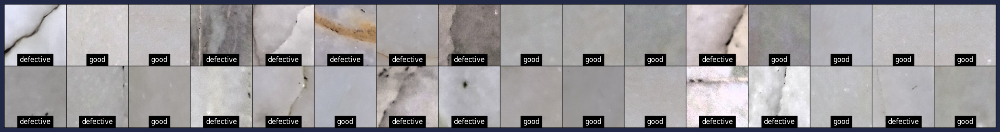

Prediction:


/tmp/ipykernel_763/2343705238.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  labels = [class_names[label] if isinstance(label, torch.Tensor) else class_names[int(label)] for label in labels]


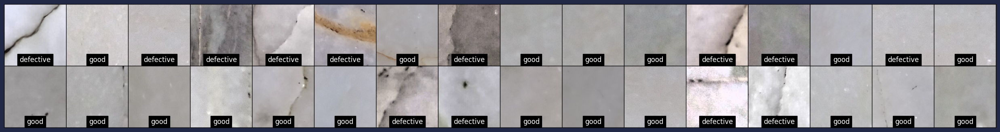

Ground truth:


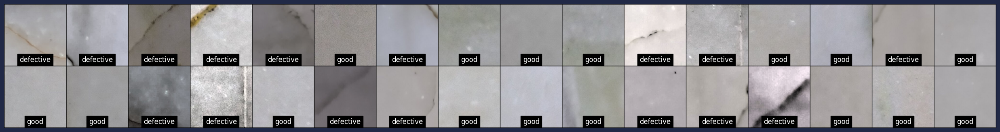

Prediction:


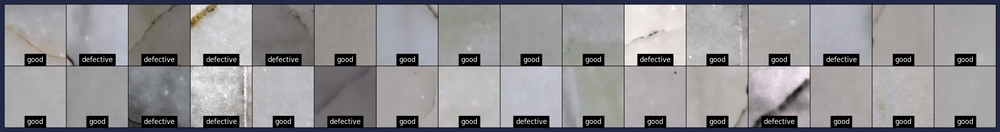

Ground truth:


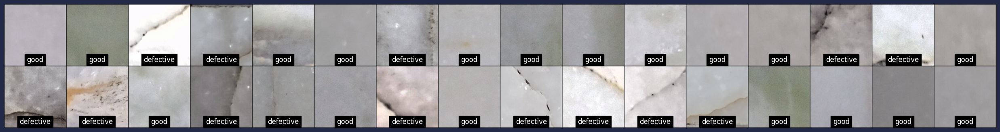

Prediction:


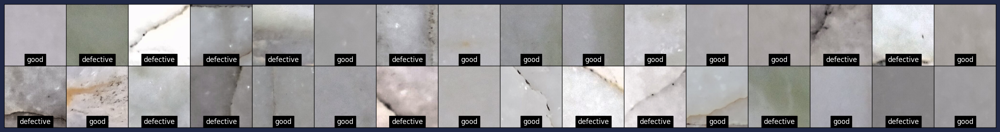

Ground truth:


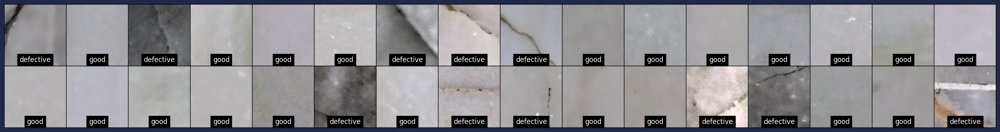

Prediction:


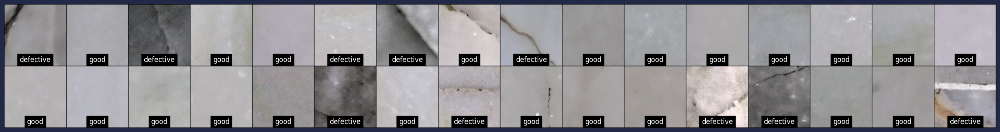

In [80]:
visualize_model(model=resnet34, dataloaders=dataloaders, num_rows=2, use_gpu=True)

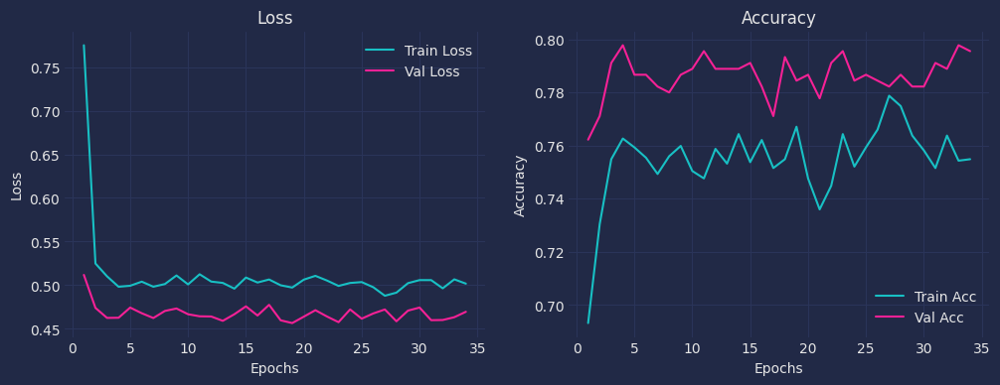

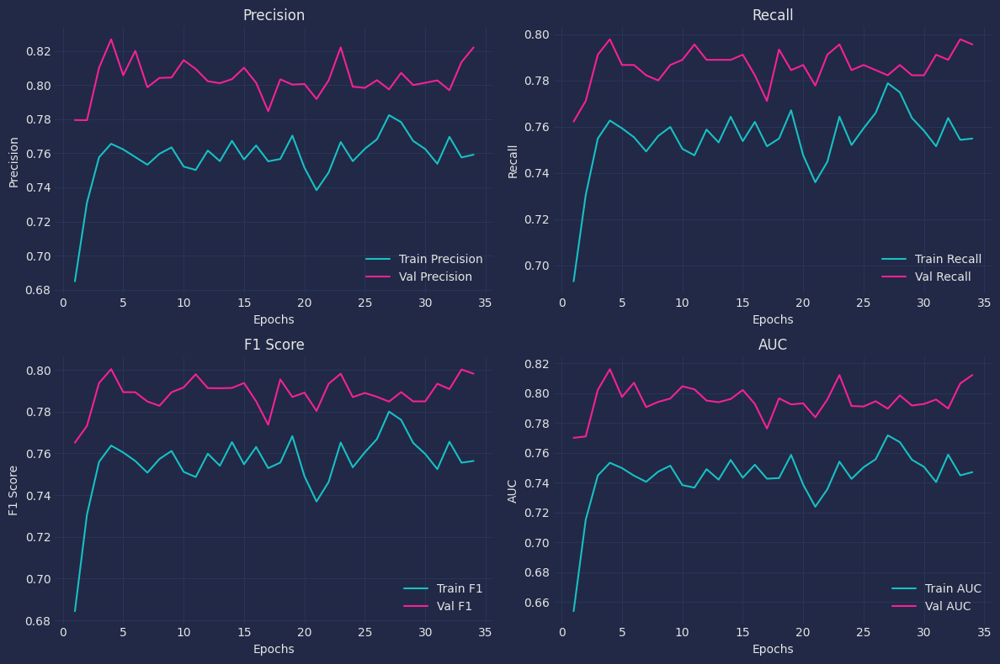

In [84]:
plot_metrics(metrics_path='Resnet34_metrics.pkl')

## ResNet50

In [95]:
# Before training evaluation
evaluate_model(model=resnet_model, criterion=criterion, split='TEST', dataloaders=dataloaders)

Test: 100%|██████████| 22/22 [00:01<00:00, 17.21it/s]

TEST Loss: 0.6941 Acc: 0.4956 Prec: 0.4951 Rec: 0.4956 F1: 0.4946 AUC: 0.4951


{'loss': 0.6940880944562513,
 'accuracy': 0.4956395348837209,
 'precision': 0.4951483765510068,
 'recall': 0.4956395348837209,
 'f1_score': 0.4946299999157683,
 'auc': 0.4951149425287356,
 'confusion_matrix': array([[188, 160],
        [187, 153]])}

In [86]:
# After training evaluation
evaluate_model(model=resnet_model, criterion=criterion, split='TEST', dataloaders=dataloaders)

Test: 100%|██████████| 22/22 [00:01<00:00, 16.74it/s]

TEST Loss: 0.4758 Acc: 0.8401 Prec: 0.8433 Rec: 0.8401 F1: 0.8396 AUC: 0.8395


{'loss': 0.4757923095725303,
 'accuracy': 0.8401162790697675,
 'precision': 0.8432938295655938,
 'recall': 0.8401162790697675,
 'f1_score': 0.8396321322580104,
 'auc': 0.8395199459093982,
 'confusion_matrix': array([[310,  38],
        [ 72, 268]])}

Ground truth:


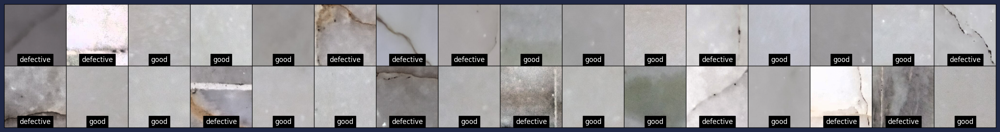

Prediction:


/tmp/ipykernel_311657/2343705238.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  labels = [class_names[label] if isinstance(label, torch.Tensor) else class_names[int(label)] for label in labels]


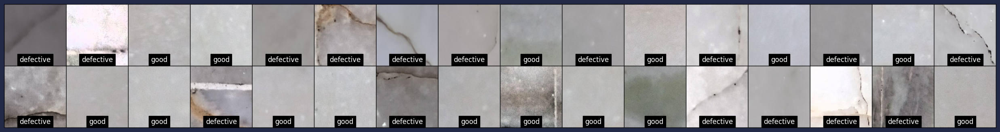

Ground truth:


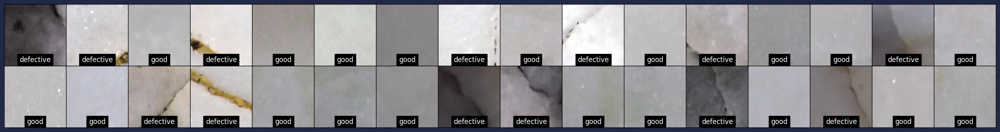

Prediction:


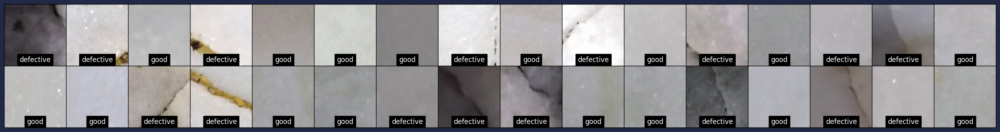

Ground truth:


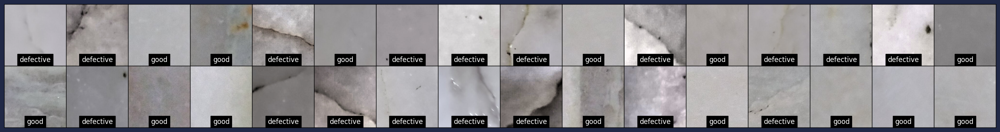

Prediction:


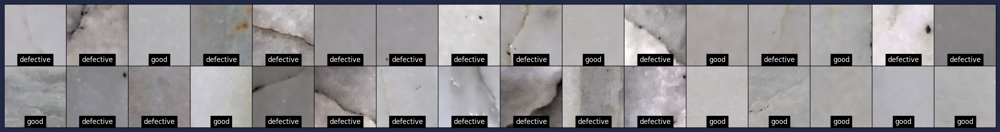

Ground truth:


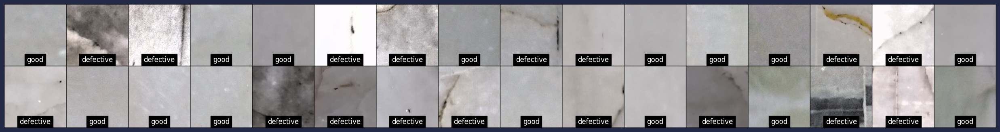

Prediction:


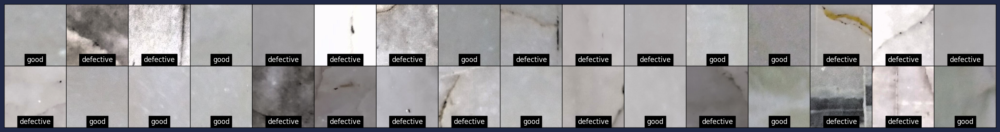

In [45]:
visualize_model(model=resnet_model, dataloaders=dataloaders, num_rows=2, use_gpu=True)

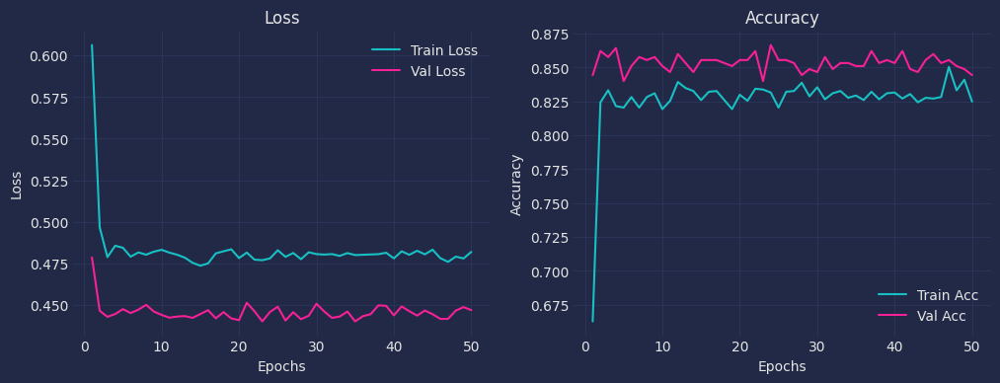

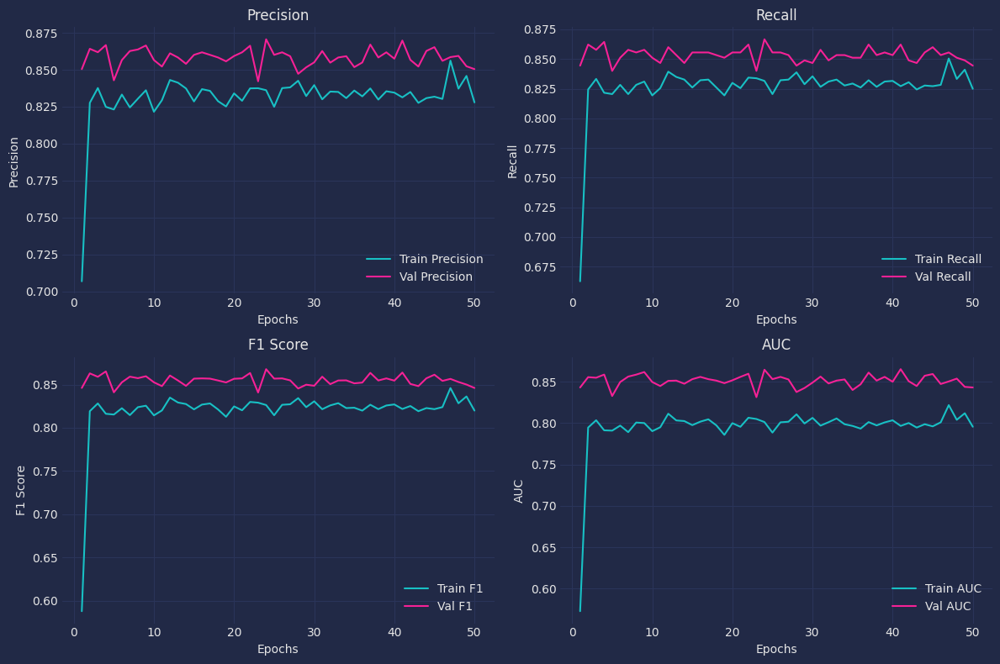

In [46]:
plot_metrics(metrics_path='Resnet_metrics.pkl')

## ViT

In [96]:
# Before training evaluation
evaluate_model(model=vit, criterion=criterion, split='TEST', dataloaders=vit_dataloaders)

Test: 100%|██████████| 22/22 [00:03<00:00,  5.68it/s]

TEST Loss: 0.6847 Acc: 0.5465 Prec: 0.5620 Rec: 0.5465 F1: 0.5090 AUC: 0.5433


{'loss': 0.6847170813139095,
 'accuracy': 0.5465116279069767,
 'precision': 0.5619759127728816,
 'recall': 0.5465116279069767,
 'f1_score': 0.5089551120325732,
 'auc': 0.5433062880324544,
 'confusion_matrix': array([[285,  63],
        [249,  91]])}

In [87]:
# After training evaluation
evaluate_model(model=vit_model, criterion=criterion, split='TEST', dataloaders=vit_dataloaders)

Test: 100%|██████████| 22/22 [00:03<00:00,  5.74it/s]

TEST Loss: 0.0521 Acc: 0.9869 Prec: 0.9869 Rec: 0.9869 F1: 0.9869 AUC: 0.9869


{'loss': 0.05209880222588084,
 'accuracy': 0.9869186046511628,
 'precision': 0.9869231618881927,
 'recall': 0.9869186046511628,
 'f1_score': 0.9869187981240866,
 'auc': 0.9869337390128465,
 'confusion_matrix': array([[343,   5],
        [  4, 336]])}

Ground truth:


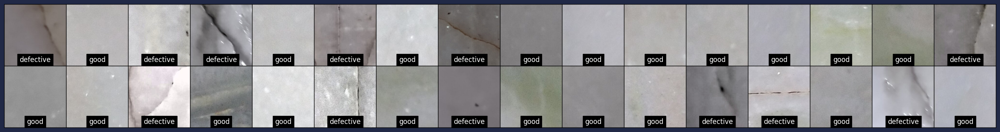

Prediction:


/tmp/ipykernel_311657/2343705238.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  labels = [class_names[label] if isinstance(label, torch.Tensor) else class_names[int(label)] for label in labels]


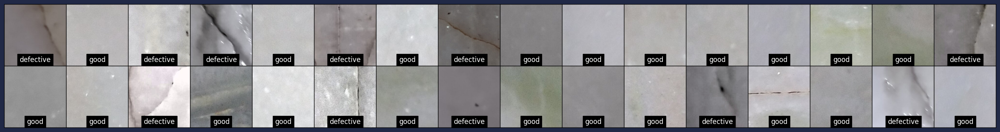

Ground truth:


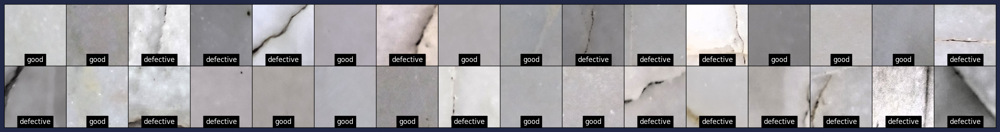

Prediction:


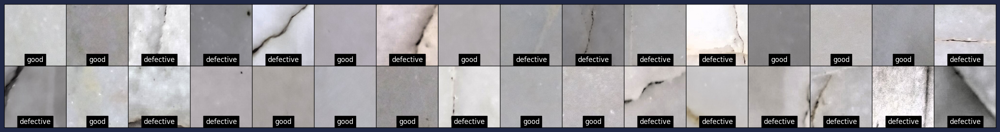

Ground truth:


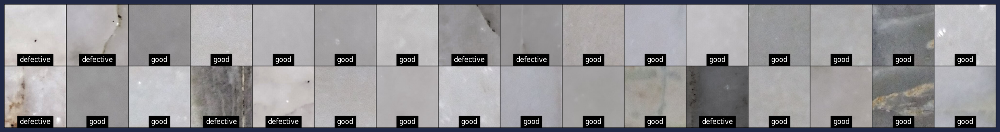

Prediction:


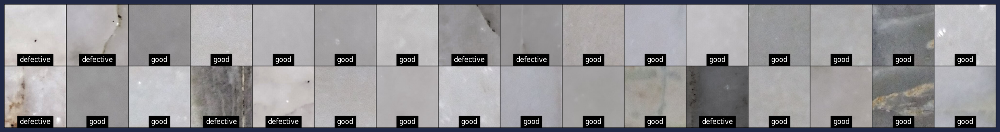

Ground truth:


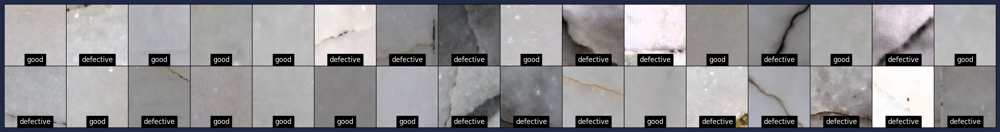

Prediction:


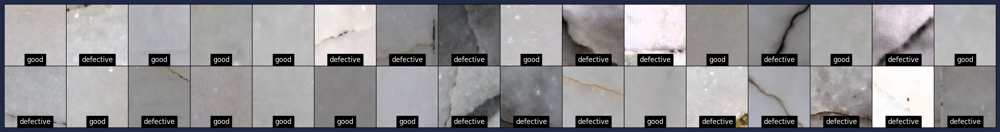

In [88]:
visualize_model(model=vit_model, dataloaders=vit_dataloaders, num_rows=2, use_gpu=True, unnormalize=False)

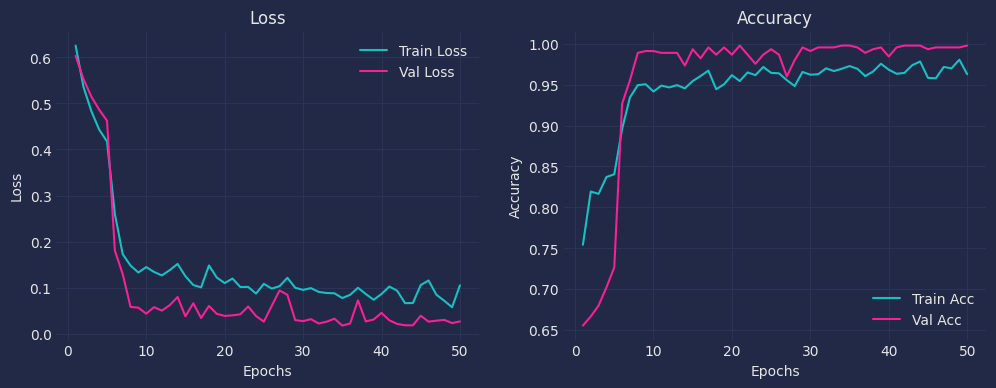

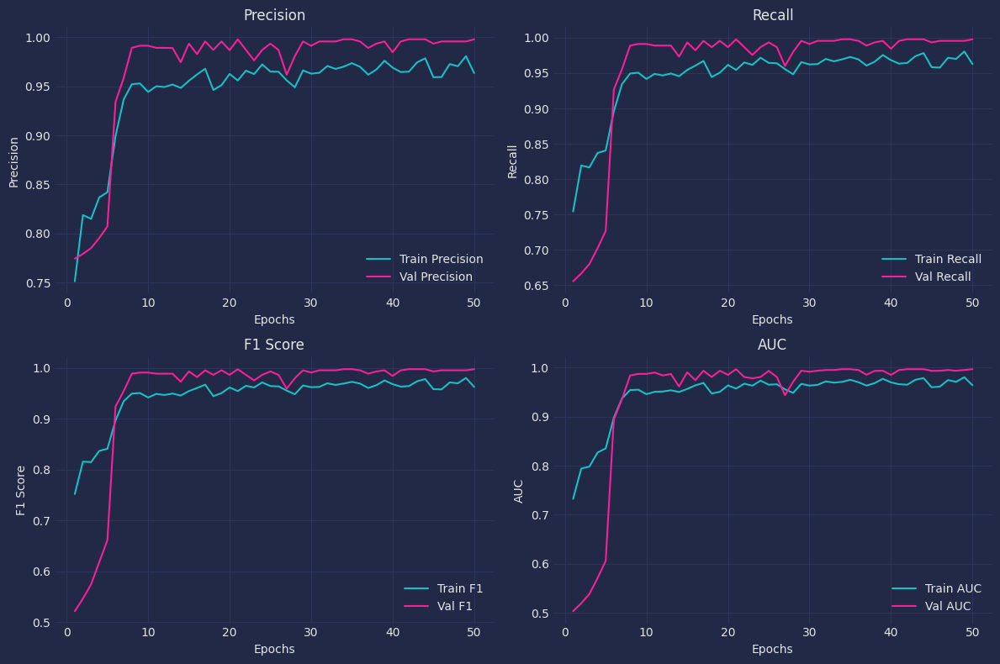

In [50]:
plot_metrics(metrics_path='vit_metrics.pkl')